<a href="https://colab.research.google.com/github/just-suraj-j/BITS-Pilani-Dissertation/blob/main/Dissertation_Task_1_Identify_task_from_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src = "https://www.bits-pilani.ac.in/Uploads/Campus/BITS_university_logo.gif">

<h1><center>Work Integrated Learning Programmes Division<br>
M.Tech (Data Science and Engineering)<br> 

## **Data Science for prevention of catastrophic occupational Injury** <br>
Name: **Suraj Kumar Jha** <br>
BITS ID: **2020sc04853** 

## **Objective** <br>


### Identification of task performed by worker from images.
<br>

The ‘Hard Hat’ dataset of workers in workplace settings, provided by Northeastern
University, China. Would be used to identification of tasks. <br><br>

**Data source** <br><br>
https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/7CBGOS

<br>
<img src="https://www.googleapis.com/download/storage/v1/b/kaggle-user-content/o/inbox%2F793761%2F6bca53ac8ff50857e15f708377a95397%2Fhard_hats.png?generation=1597132002705580&alt=media">




**Data Science** <br><br>
The accelerating volume of data sources, and subsequently data, has made data science is
one of the fastest growing fields across every industry. Organizations are increasingly
reliant on them to interpret data and provide actionable recommendations to improve
business outcomes.<br><br>
Data science combines math and statistics, specialized programming, advanced analytics,
artificial intelligence (AI), and machine learning with specific subject matter expertise to
uncover actionable insights hidden in an organization’s data. These insights can be used to
guide decision making and strategic planning.

**Computer vision** <br><br>
Computer vision works much the same as human vision, except humans have a head start.
Human sight has the advantage of lifetimes of context to train how to tell objects apart, how
far away they are, whether they are moving and whether there is something wrong in an
image.<br><br>
Computer vision is a field of artificial intelligence (AI) that enables computers and systems to
derive meaningful information from digital images, videos, and other visual inputs — and take
actions or make recommendations based on that information. If AI enables computers to
think, computer vision enables them to see, observe and understand

**Natural Language Processing**<br><br>

Natural language processing (NLP) refers to the branch of computer science—and more
specifically, the branch of artificial intelligence or AI—concerned with giving computers the
ability to understand text and spoken words in much the same way human beings can.<br><br>
NLP combines computational linguistics—rule-based modeling of human language—with
statistical, machine learning, and deep learning models. Together, these technologies enable
computers to process human language in the form of text or voice data and to ‘understand’ its
full meaning, complete with the speaker or writer’s intent and sentiment.
, outreach, education, and assistance".

**Deep learning** <br><br>
Deep learning drives many artificial intelligence (AI) applications and services that improve
automation, performing analytical and physical tasks without human intervention. <br><br>
Deep learning is a subset of machine learning, which is essentially a neural network with three
or more layers. These neural networks attempt to simulate the behavior of the human brain—
albeit far from matching its ability—allowing it to “learn” from large amounts of data. While a
neural network with a single layer can still make approximate predictions, additional hidden
layers can help to optimize and refine for accuracy.

### Utilising GPU


In [ ]:
#Testing GPU
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
#List of local device
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 16114095303119976756
 xla_global_id: -1, name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14415560704
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 16315103813550097744
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
 xla_global_id: 416903419]

In [ ]:
#Available memory resources
!cat /proc/meminfo

MemTotal:       13297200 kB
MemFree:         7954308 kB
MemAvailable:   11518684 kB
Buffers:          342548 kB
Cached:          3401984 kB
SwapCached:            0 kB
Active:           796876 kB
Inactive:        4178580 kB
Active(anon):        936 kB
Inactive(anon):  1224676 kB
Active(file):     795940 kB
Inactive(file):  2953904 kB
Unevictable:           0 kB
Mlocked:               0 kB
SwapTotal:             0 kB
SwapFree:              0 kB
Dirty:              1792 kB
Writeback:             0 kB
AnonPages:       1230984 kB
Mapped:           708992 kB
Shmem:             11464 kB
KReclaimable:     111968 kB
Slab:             154356 kB
SReclaimable:     111968 kB
SUnreclaim:        42388 kB
KernelStack:        5872 kB
PageTables:        11492 kB
NFS_Unstable:          0 kB
Bounce:                0 kB
WritebackTmp:          0 kB
CommitLimit:     6648600 kB
Committed_AS:    4105792 kB
VmallocTotal:   34359738367 kB
VmallocUsed:       54444 kB
VmallocChunk:          0 kB
Percpu:          

#Identify tasks from dataset Images

### **Mount Google Drive to get the stored images and captions**

In [ ]:
#Connect to Google drive to fetch data
from google.colab import drive
drive.mount("/content/gdrive")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


### **Importing required libraries**

In [ ]:
#Import required libraries
import os
import re
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.applications import vgg16
from tensorflow.keras.applications import vgg19
from tensorflow.keras.applications import resnet50
from tensorflow.keras.applications import inception_v3
from tensorflow.keras.applications import efficientnet
from tensorflow.keras.applications import xception
from tensorflow.keras.layers import TextVectorization


### **Set Parameters and values**

In [ ]:
# Path to the images from Hardhat dataset
FILE_PATH = "/content/gdrive/MyDrive/Dissertation/Hardhat/Hardhat/Input/Images"
TOKENS_PATH="/content/gdrive/MyDrive/Dissertation/Hardhat/Hardhat/Input/Caption/hardhattoken.txt"

# Set desired image dimensions
IMG_SIZE = (256, 256)

# Set vocabulary size
VOCAB_SIZE = 1000

# Set fixed length allowed for any sequence
SEQ_LENGTH = 25

# Set dimension for the image embeddings and token embeddings
EMBED_DIM = 512

# Set per-layer units in the feed-forward network
FF_DIM = 512

# Set other training parameters
BATCH_SIZE = 64
EPOCHS = 15
AUTOTUNE = tf.data.AUTOTUNE
seed = 111
np.random.seed(seed)
tf.random.set_seed(seed)

### **Loading Images and Task Description**

In [ ]:
#Declare dictionary and list to store tasks and sequence
task_map = {}
seq_data = []

#Open filepath to read each line
with open(TOKENS_PATH) as token_file:
        task_tokens = token_file.readlines()

#Read the each line and identify predefined tasks for each image
for lin in task_tokens:
# Read each line   
  lin = lin.rstrip("\n")
#Split read line into name of image and token to identify task being performed
  img, task = lin.split("     ")
  img = img.split("#")[0]
# join the image name with filepath  
  img = os.path.join(FILE_PATH, img.strip())
  tokens = task.strip().split()
#Convert tokens to sequence
  if img.endswith("jpg") :
    task = "<start> " + task.strip() + " <end>"
    seq_data.append(task)
    if img in task_map:
      task_map[img].append(task)
    else:
      task_map[img] = [task]


### **Display images with task description sequence**

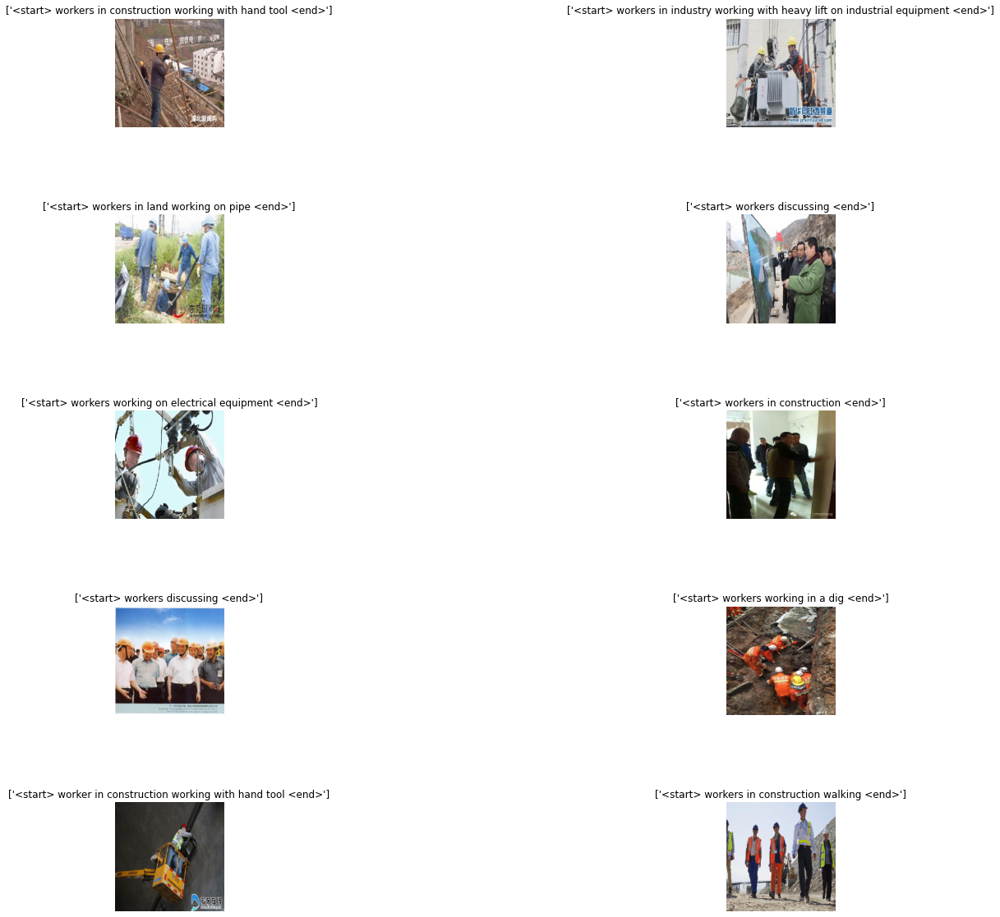

In [ ]:
count=0
n=0
plt.figure(figsize = (20 , 20))
for i in task_map.keys():
  if count<10:
    n+=1
    plt.subplot(5 , 2, n)
    plt.subplots_adjust(hspace = 0.8, wspace = 1)
    img = load_img(i,color_mode='rgb',target_size=(299,299))
    plt.title(task_map[i])
    img = img_to_array(img)
    img = img/255.
    plt.imshow(img)
    plt.axis("off")
    count=count+1

### **Data Preparation for Training and Validation**

In [ ]:
#Split training and validation data
def training_val_split(task_data, train_size=0.80, shuffle=True):
    imageList = list(task_data.keys())
    if shuffle:
        np.random.shuffle(imageList)
    training_size = int(len(task_data) * train_size)

    training_data = {
        img_name: task_data[img_name] for img_name in imageList[:training_size]
    }
    validation_data = {
        img_name: task_data[img_name] for img_name in imageList[training_size:]
    }
    return training_data, validation_data

# Split the dataset into training and validation sets
train_data, valid_data = training_val_split(task_map)
print("Number of training samples: ", len(train_data))
print("Number of validation samples: ", len(valid_data))

Number of training samples:  3200
Number of validation samples:  800


In [ ]:
#preprocessing of text data
def custom_standard(input):
  lower=tf.strings.lower(input)
  custom = tf.strings.regex_replace(lower, '<','')
  custom = tf.strings.regex_replace(custom, '>','')
  return custom

vectorize = TextVectorization(
    max_tokens=VOCAB_SIZE,
    output_mode="int",
    output_sequence_length=SEQ_LENGTH,
    standardize=custom_standard,
)
vectorize.adapt(seq_data)

# Data augmentation for image data
image_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.2),
        layers.RandomContrast(0.3),
    ]
)

In [ ]:
#Prepare training and validation data
def process_input(img_path, captions):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img,IMG_SIZE)
    img = tf.image.convert_image_dtype(img, tf.float32)
    cap=vectorize(captions)
    return img,cap 


def make_dataset(images, captions):
    dataset = tf.data.Dataset.from_tensor_slices((images, captions))
    dataset = dataset.shuffle(BATCH_SIZE * 8)
    dataset = dataset.map(process_input, num_parallel_calls=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE).prefetch(AUTOTUNE)
    return dataset


# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()))

valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()))


### **Defining Transformer Encoder and Decoder Architecture**

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-424.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-425.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-429.png?w=800&ssl=1">

<img src="https://i0.wp.com/kikaben.com/wp-content/uploads/2022/04/image-449.png?w=800&ssl=1">

In [ ]:
#@title
class TransformerEncoder(layers.Layer):
    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.0
        )
        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.dense_1 = layers.Dense(embed_dim, activation="relu")

    def call(self, inputs, training, mask=None):
        inputs = self.layernorm_1(inputs)
        inputs = self.dense_1(inputs)

        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=None,
            training=training,
        )
        out_1 = self.layernorm_2(inputs + attention_output_1)
        return out_1


class PositionalEmbed(layers.Layer):
    def __init__(self, sequence_length, vocab_size, embed_dim, **kwargs):
        super().__init__(**kwargs)
        self.token_embeddings = layers.Embedding(
            input_dim=vocab_size, output_dim=embed_dim
        )
        self.position_embeddings = layers.Embedding(
            input_dim=sequence_length, output_dim=embed_dim
        )
        self.sequence_length = sequence_length
        self.vocab_size = vocab_size
        self.embed_dim = embed_dim
        self.embed_scale = tf.math.sqrt(tf.cast(embed_dim, tf.float32))

    def call(self, inputs):
        length = tf.shape(inputs)[-1]
        positions = tf.range(start=0, limit=length, delta=1)
        embedded_tokens = self.token_embeddings(inputs)
        embedded_tokens = embedded_tokens * self.embed_scale
        embedded_positions = self.position_embeddings(positions)
        return embedded_tokens + embedded_positions

    def compute_mask(self, inputs, mask=None):
        return tf.math.not_equal(inputs, 0)


class TransformerDecoder(layers.Layer):
    def __init__(self, embed_dim, ff_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.ff_dim = ff_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.1
        )
        self.attention_2 = layers.MultiHeadAttention(
            num_heads=num_heads, key_dim=embed_dim, dropout=0.1
        )
        self.ffn_layer_1 = layers.Dense(ff_dim, activation="relu")
        self.ffn_layer_2 = layers.Dense(embed_dim)

        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.layernorm_3 = layers.LayerNormalization()

        self.embedding = PositionalEmbed(
            embed_dim=EMBED_DIM, sequence_length=SEQ_LENGTH, vocab_size=VOCAB_SIZE
        )
        self.out = layers.Dense(VOCAB_SIZE, activation="softmax")

        self.dropout_1 = layers.Dropout(0.3)
        self.dropout_2 = layers.Dropout(0.5)
        self.supports_masking = True

    def call(self, inputs, encoder_outputs, training, mask=None):
        inputs = self.embedding(inputs)
        causal_mask = self.get_causal_attention_mask(inputs)

        if mask is not None:
            padding_mask = tf.cast(mask[:, :, tf.newaxis], dtype=tf.int32)
            combined_mask = tf.cast(mask[:, tf.newaxis, :], dtype=tf.int32)
            combined_mask = tf.minimum(combined_mask, causal_mask)

        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=combined_mask,
            training=training,
        )
        out_1 = self.layernorm_1(inputs + attention_output_1)

        attention_output_2 = self.attention_2(
            query=out_1,
            value=encoder_outputs,
            key=encoder_outputs,
            attention_mask=padding_mask,
            training=training,
        )
        out_2 = self.layernorm_2(out_1 + attention_output_2)

        ffn_out = self.ffn_layer_1(out_2)
        ffn_out = self.dropout_1(ffn_out, training=training)
        ffn_out = self.ffn_layer_2(ffn_out)

        ffn_out = self.layernorm_3(ffn_out + out_2, training=training)
        ffn_out = self.dropout_2(ffn_out, training=training)
        preds = self.out(ffn_out)
        return preds

    def get_causal_attention_mask(self, inputs):
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        mult = tf.concat(
            [tf.expand_dims(batch_size, -1), tf.constant([1, 1], dtype=tf.int32)],
            axis=0,
        )
        return tf.tile(mask, mult)

In [ ]:
class TaskIdentification(keras.Model):
    def __init__(
        self, cnn_model, encoder, decoder, num_captions_per_image=1, image_aug=None,
    ):
        super().__init__()
        self.cnn_model = cnn_model
        self.encoder = encoder
        self.decoder = decoder
        self.loss_tracker = keras.metrics.Mean(name="loss")
        self.acc_tracker = keras.metrics.Mean(name="accuracy")
        self.num_captions_per_image = num_captions_per_image
        self.image_aug = image_aug

    def calculate_loss(self, y_true, y_pred, mask):
        loss = self.loss(y_true, y_pred)
        mask = tf.cast(mask, dtype=loss.dtype)
        loss *= mask
        return tf.reduce_sum(loss) / tf.reduce_sum(mask)

    def calculate_accuracy(self, y_true, y_pred, mask):
        accuracy = tf.equal(y_true, tf.argmax(y_pred, axis=2))
        accuracy = tf.math.logical_and(mask, accuracy)
        accuracy = tf.cast(accuracy, dtype=tf.float32)
        mask = tf.cast(mask, dtype=tf.float32)
        return tf.reduce_sum(accuracy) / tf.reduce_sum(mask)

    def _compute_caption_loss_and_acc(self, img_embed, batch_seq, training=True):
        encoder_out = self.encoder(img_embed, training=training)
        batch_seq_inp = batch_seq[:, :-1]
        batch_seq_true = batch_seq[:, 1:]
        mask = tf.math.not_equal(batch_seq_true, 0)
        batch_seq_pred = self.decoder(
            batch_seq_inp, encoder_out, training=training, mask=mask
        )
        loss = self.calculate_loss(batch_seq_true, batch_seq_pred, mask)
        acc = self.calculate_accuracy(batch_seq_true, batch_seq_pred, mask)
        return loss, acc

    def train_step(self, batch_data):
        batch_img, batch_seq = batch_data
        batch_loss = 0
        batch_acc = 0

        if self.image_aug:
            batch_img = self.image_aug(batch_img)

        # 1. Get image embeddings
        img_embed = self.cnn_model(batch_img)

        # 2. Pass each of the captions one by one to the decoder
        # along with the encoder outputs and compute the loss as well as accuracy
        # for each caption.
        for i in range(self.num_captions_per_image):
            with tf.GradientTape() as tape:
                loss, acc = self._compute_caption_loss_and_acc(
                    img_embed, batch_seq[:, i, :], training=True
                )

                # 3. Update loss and accuracy
                batch_loss += loss
                batch_acc += acc

            # 4. Get the list of all the trainable weights
            train_vars = (
                self.encoder.trainable_variables + self.decoder.trainable_variables
            )

            # 5. Get the gradients
            grads = tape.gradient(loss, train_vars)

            # 6. Update the trainable weights
            self.optimizer.apply_gradients(zip(grads, train_vars))

        # 7. Update the trackers
        batch_acc /= float(self.num_captions_per_image)
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc)

        # 8. Return the loss and accuracy values
        return {"loss": self.loss_tracker.result(), "acc": self.acc_tracker.result()}

    def test_step(self, batch_data):
        batch_img, batch_seq = batch_data
        batch_loss = 0
        batch_acc = 0

        # 1. Get image embeddings
        img_embed = self.cnn_model(batch_img)

        # 2. Pass each of the five captions one by one to the decoder
        # along with the encoder outputs and compute the loss as well as accuracy
        # for each caption.
        for i in range(self.num_captions_per_image):
            loss, acc = self._compute_caption_loss_and_acc(
                img_embed, batch_seq[:, i, :], training=False
            )

            # 3. Update batch loss and batch accuracylearning
            batch_loss += loss
            batch_acc += acc

        batch_acc /= float(self.num_captions_per_image)

        # 4. Update the trackers
        self.loss_tracker.update_state(batch_loss)
        self.acc_tracker.update_state(batch_acc)

        # 5. Return the loss and accuracy values
        return {"loss": self.loss_tracker.result(), "acc": self.acc_tracker.result()}

    @property
    def metrics(self):
        # We need to list our metrics here so the `reset_states()` can be
        # called automatically.
        return [self.loss_tracker, self.acc_tracker]

In [ ]:
# Define the loss function
cross_entropy = keras.losses.SparseCategoricalCrossentropy(
    from_logits=False, reduction="none"
)

# EarlyStopping criteria
early_stopping = keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True)


# Learning Rate Scheduler for the optimizer
class LearnRateSchedule(keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, post_warmup_learning_rate, warmup_steps):
        super().__init__()
        self.post_warmup_learning_rate = post_warmup_learning_rate
        self.warmup_steps = warmup_steps

    def __call__(self, step):
        global_step = tf.cast(step, tf.float32)
        warmup_steps = tf.cast(self.warmup_steps, tf.float32)
        warmup_progress = global_step / warmup_steps
        warmup_learning_rate = self.post_warmup_learning_rate * warmup_progress
        return tf.cond(
            global_step < warmup_steps,
            lambda: warmup_learning_rate,
            lambda: self.post_warmup_learning_rate,
        )


# Create a learning rate schedule
num_train_steps = len(train_dataset) * EPOCHS
num_warmup_steps = num_train_steps // 15
lr_schedule = LearnRateSchedule(post_warmup_learning_rate=1e-4, warmup_steps=num_warmup_steps)

In [ ]:
vocab = vectorize.get_vocabulary()
index_lookup = dict(zip(range(len(vocab)), vocab))
max_decoded_sentence_length = SEQ_LENGTH - 1
valid_images = list(valid_data.keys())

def generate_caption():
    # Select a random image from the validation dataset
    sample_img = np.random.choice(valid_images)

    # Read the image from the disk
    read_img = tf.io.read_file(sample_img)
    dec_img = tf.image.decode_jpeg(read_img, channels=3)
    res_img = tf.image.resize(dec_img,IMG_SIZE)
    sample_img = tf.image.convert_image_dtype(res_img, tf.float32)
    img = sample_img.numpy().clip(0, 255).astype(np.uint8)
    plt.imshow(img)
    plt.show()

    # Pass the image to the CNN
    img = tf.expand_dims(sample_img, 0)
    img = caption_model.cnn_model(img)

    # Pass the image features to the Transformer encoder
    encoded_img = caption_model.encoder(img, training=False)

    # Generate the caption using the Transformer decoder
    decoded_caption = "<start> "
    for i in range(max_decoded_sentence_length):
        tokenized_caption = vectorize([decoded_caption])[:, :-1]
        mask = tf.math.not_equal(tokenized_caption, 0)
        predictions = caption_model.decoder(
            tokenized_caption, encoded_img, training=False, mask=mask
        )
        sampled_token_index = np.argmax(predictions[0, i, :])
        sampled_token = index_lookup[sampled_token_index]
        if sampled_token == "end":
            break
        decoded_caption += " " + sampled_token

    decoded_caption = decoded_caption.replace("<start> ", "")
    decoded_caption = decoded_caption.replace(" <end>", "").strip()
    print("Predicted task: ", decoded_caption)

In [ ]:
def plot_loss(title,history):
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title(title)
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  return

def plot_accuracy(title,history):
  plt.plot(history.history['acc'])
  plt.plot(history.history['val_acc'])
  plt.title(title)
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  return


**Transfer Learning for Training Deep Learning Models**

Transfer learning is a deep learning approach in which a model that has been trained for one task is used as a starting point for a model that performs a similar task. Updating and retraining a network with transfer learning is usually much faster and easier than training a network from scratch.

Transfer learning is a popular technique because:

*   It enables you to train models with less labeled data by reusing popular models that have already been trained on large datasets.<br>
*   It can reduce training time and computing resources. <br>
*   You can take advantage of model architectures developed by the deep learning research community.





### **Implementing Transformer model with pretrained VGG16**

In [ ]:
def pretrained_vgg16():
    vgg = vgg16.VGG16(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    vgg.trainable = False
    outputs = vgg.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(vgg.input, outputs)
    return model

In [ ]:
model = pretrained_vgg16()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

58889256/58889256 [==============================] - 3s 0us/step


### **Model Evaluation**

In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15


50/50 [==============================] - 1133s 22s/step - loss: 4.7450 - acc: 0.0941 - val_loss: 1.5647 - val_acc: 0.6314
Epoch 2/15
50/50 [==============================] - 46s 903ms/step - loss: 1.2707 - acc: 0.6151 - val_loss: 0.7616 - val_acc: 0.7309
Epoch 3/15
50/50 [==============================] - 46s 910ms/step - loss: 0.8720 - acc: 0.7008 - val_loss: 0.6508 - val_acc: 0.7536
Epoch 4/15
50/50 [==============================] - 46s 920ms/step - loss: 0.7586 - acc: 0.7307 - val_loss: 0.5731 - val_acc: 0.7784
Epoch 5/15
50/50 [==============================] - 46s 923ms/step - loss: 0.7092 - acc: 0.7450 - val_loss: 0.5517 - val_acc: 0.7920
Epoch 6/15
50/50 [==============================] - 47s 926ms/step - loss: 0.6558 - acc: 0.7665 - val_loss: 0.5315 - val_acc: 0.7892
Epoch 7/15
50/50 [==============================] - 48s 962ms/step - loss: 0.6378 - acc: 0.7634 - val_loss: 0.5134 - val_acc: 0.8000
Epoch 8/15
50/50 [==============================] - 47s 924ms/step - loss: 0.613

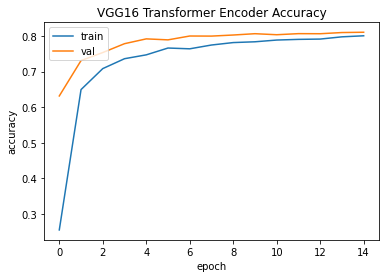

In [ ]:
plot_accuracy('VGG16 Transformer Encoder Accuracy',history)

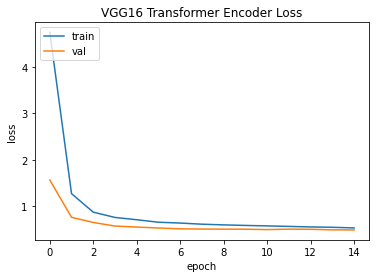

In [ ]:
plot_loss('VGG16 Transformer Encoder Loss',history)

### **Prediction Results**

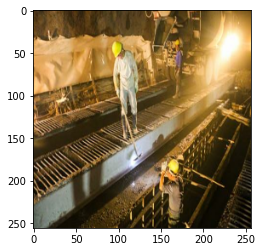

Predicted task:  workers in construction working


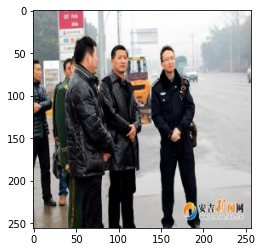

Predicted task:  workers discussing


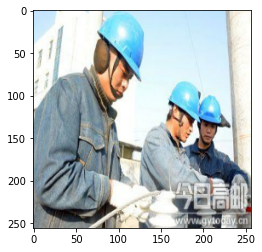

Predicted task:  workers working on electrical equipment


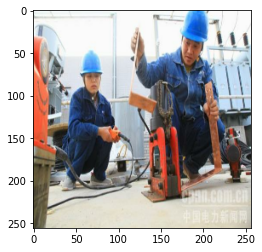

Predicted task:  workers in construction working


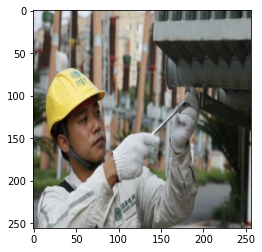

Predicted task:  workers discussing


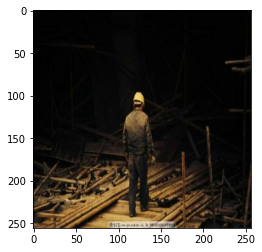

Predicted task:  worker in construction working


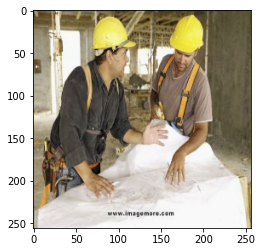

Predicted task:  workers discussing


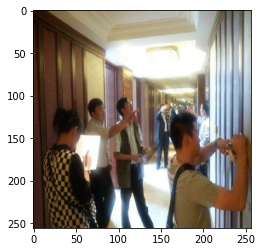

Predicted task:  workers discussing


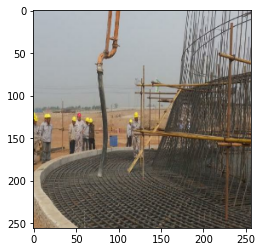

Predicted task:  workers in construction working


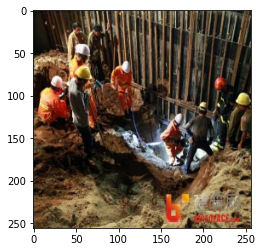

Predicted task:  workers discussing


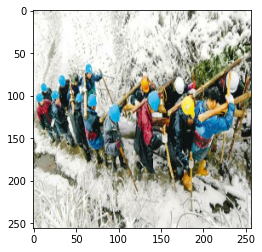

Predicted task:  workers working in a dig


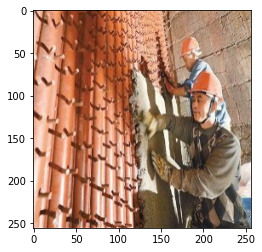

Predicted task:  worker working on electrical equipment


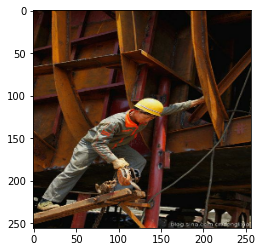

Predicted task:  worker working on electrical equipment


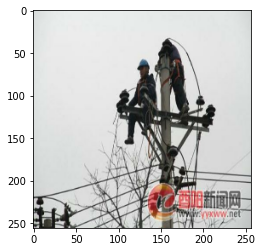

Predicted task:  workers working on electrical equipment


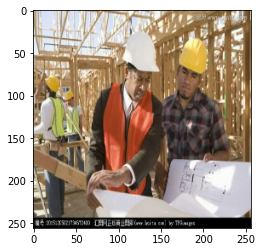

Predicted task:  workers discussing


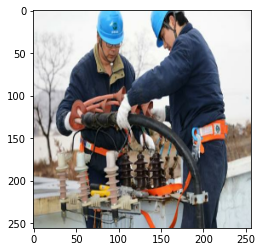

Predicted task:  workers working on electrical equipment


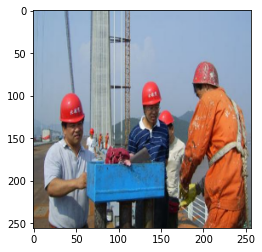

Predicted task:  workers discussing


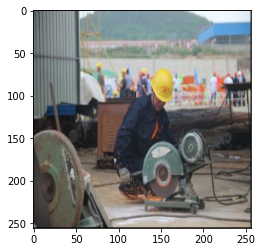

Predicted task:  workers working on industrial equipment


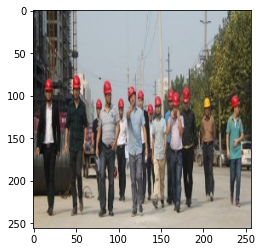

Predicted task:  workers discussing


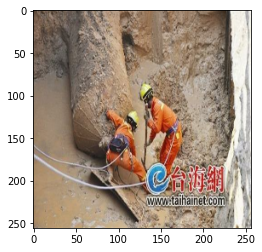

Predicted task:  workers working in a dig


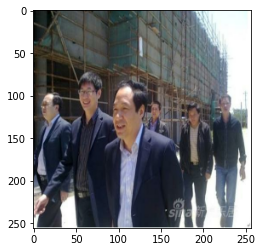

Predicted task:  workers discussing


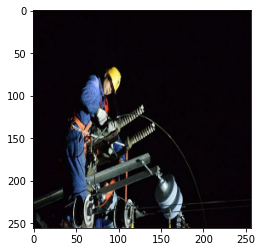

Predicted task:  workers working on electrical equipment


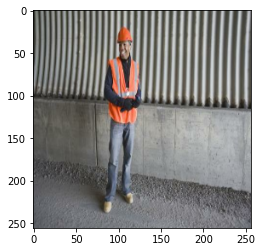

Predicted task:  workers standing


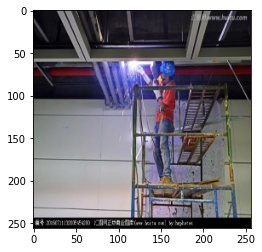

Predicted task:  worker working on electrical equipment


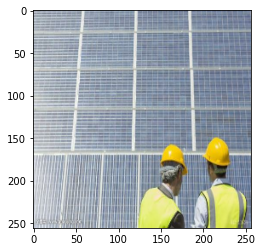

Predicted task:  worker standing


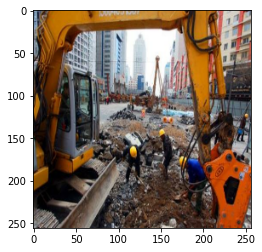

Predicted task:  workers in construction working


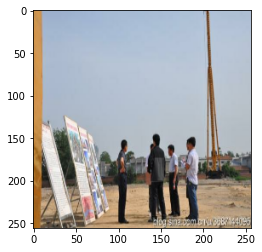

Predicted task:  workers discussing


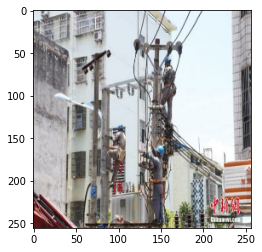

Predicted task:  workers working on electrical equipment


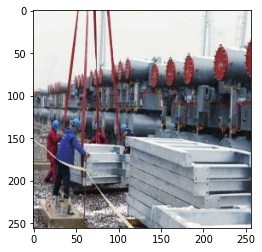

Predicted task:  workers discussing


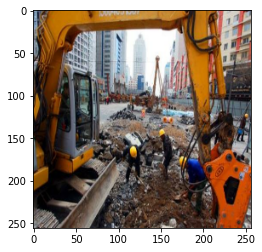

Predicted task:  workers in construction working


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained VGG19**

In [ ]:
def pretrained_vgg19():
    vgg = vgg19.VGG19(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    vgg.trainable = False
    outputs = vgg.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(vgg.input, outputs)
    return model

In [ ]:
model = pretrained_vgg19()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

80134624/80134624 [==============================] - 4s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15


50/50 [==============================] - 55s 1s/step - loss: 4.8746 - acc: 0.0948 - val_loss: 1.6474 - val_acc: 0.5685
Epoch 2/15
50/50 [==============================] - 51s 1s/step - loss: 1.2890 - acc: 0.6227 - val_loss: 0.7716 - val_acc: 0.7534
Epoch 3/15
50/50 [==============================] - 51s 1s/step - loss: 0.8639 - acc: 0.6982 - val_loss: 0.6316 - val_acc: 0.7660
Epoch 4/15
50/50 [==============================] - 50s 1s/step - loss: 0.7455 - acc: 0.7318 - val_loss: 0.5754 - val_acc: 0.7773
Epoch 5/15
50/50 [==============================] - 50s 1s/step - loss: 0.7105 - acc: 0.7389 - val_loss: 0.5583 - val_acc: 0.7860
Epoch 6/15
50/50 [==============================] - 51s 1s/step - loss: 0.6674 - acc: 0.7530 - val_loss: 0.5350 - val_acc: 0.7915
Epoch 7/15
50/50 [==============================] - 51s 1s/step - loss: 0.6429 - acc: 0.7574 - val_loss: 0.5206 - val_acc: 0.7947
Epoch 8/15
50/50 [==============================] - 50s 1s/step - loss: 0.6211 - acc: 0.7678 - val_lo

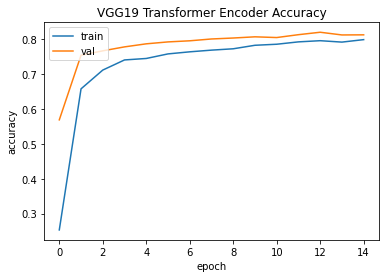

In [ ]:
plot_accuracy('VGG19 Transformer Encoder Accuracy',history)

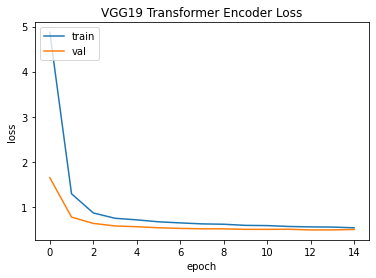

In [ ]:
plot_loss('VGG19 Transformer Encoder Loss',history)

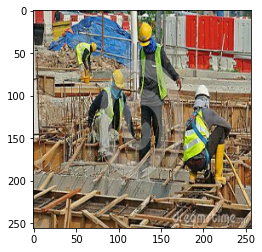

Predicted task:  workers in construction working


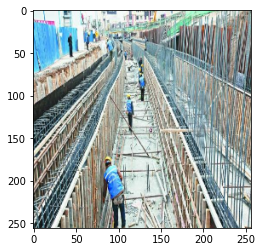

Predicted task:  worker in construction working


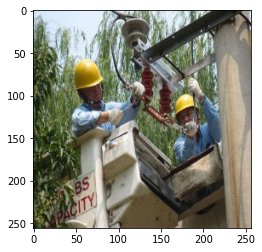

Predicted task:  workers working on electrical equipment


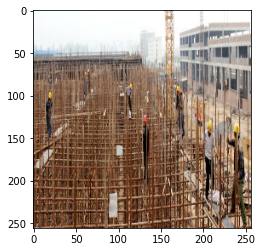

Predicted task:  workers in construction working


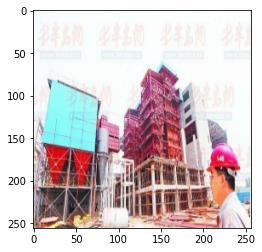

Predicted task:  workers in construction working


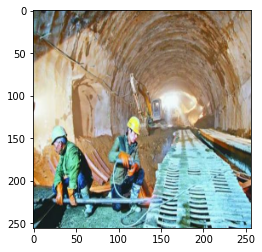

Predicted task:  workers working in a dig


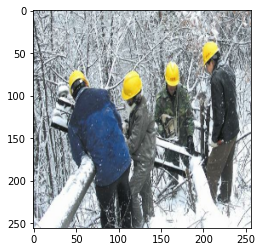

Predicted task:  workers working on electrical equipment


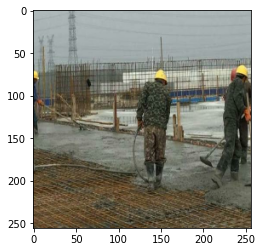

Predicted task:  workers in construction working


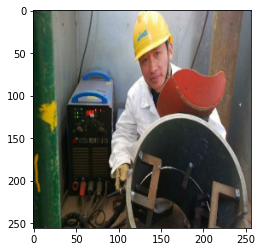

Predicted task:  worker in industry working with hand tool


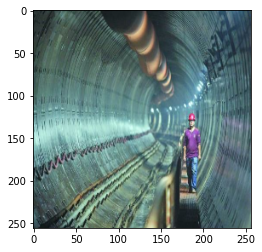

Predicted task:  worker in construction working with hand tool


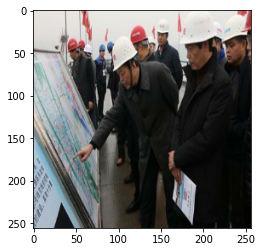

Predicted task:  workers discussing


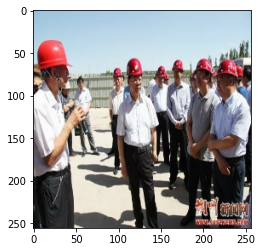

Predicted task:  workers discussing


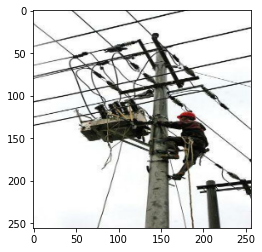

Predicted task:  worker working on electrical equipment


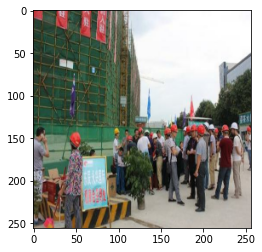

Predicted task:  workers discussing


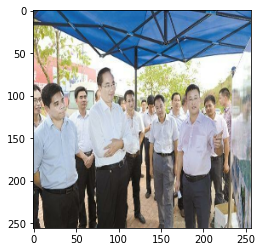

Predicted task:  workers discussing


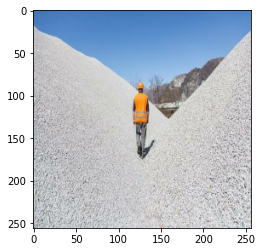

Predicted task:  worker standing


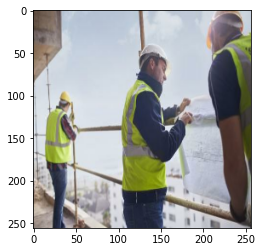

Predicted task:  workers discussing


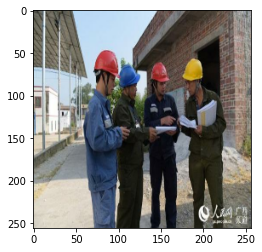

Predicted task:  workers discussing


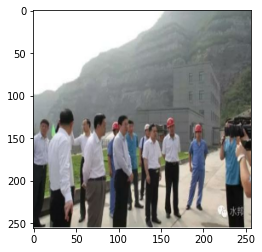

Predicted task:  workers discussing


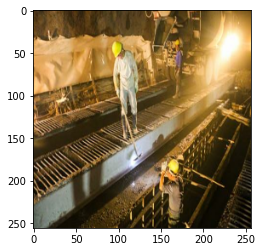

Predicted task:  workers in construction working with hand tool


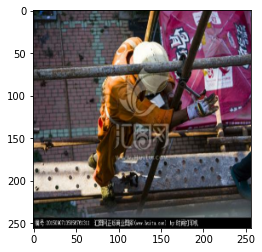

Predicted task:  worker in construction working


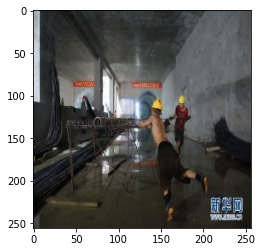

Predicted task:  workers in construction working


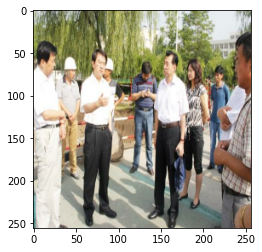

Predicted task:  workers discussing


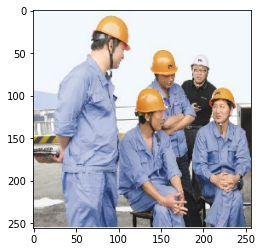

Predicted task:  workers discussing


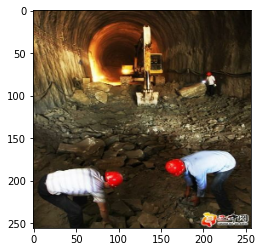

Predicted task:  workers working in a dig


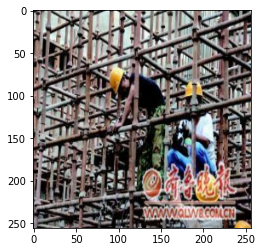

Predicted task:  workers working on height


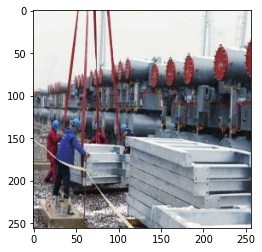

Predicted task:  workers in construction working


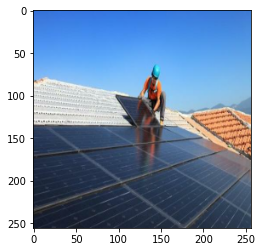

Predicted task:  worker in construction working with hand tool


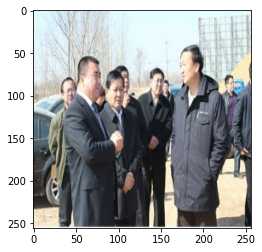

Predicted task:  workers discussing


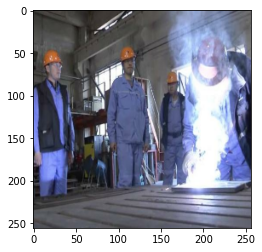

Predicted task:  workers in construction working


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained ResNet50**

In [ ]:
def pretrained_resnet50():
    rsnt = resnet50.ResNet50(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    rsnt.trainable = False
    outputs = rsnt.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(rsnt.input, outputs)
    return model

In [ ]:
model = pretrained_resnet50()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

94765736/94765736 [==============================] - 5s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 23s 369ms/step - loss: 4.9173 - acc: 0.1030 - val_loss: 1.6164 - val_acc: 0.5687
Epoch 2/15
50/50 [==============================] - 17s 329ms/step - loss: 1.2493 - acc: 0.6184 - val_loss: 0.7215 - val_acc: 0.7507
Epoch 3/15
50/50 [==============================] - 17s 331ms/step - loss: 0.8004 - acc: 0.7226 - val_loss: 0.5786 - val_acc: 0.7893
Epoch 4/15
50/50 [==============================] - 17s 331ms/step - loss: 0.6703 - acc: 0.7700 - val_loss: 0.5394 - val_acc: 0.8003
Epoch 5/15
50/50 [==============================] - 17s 333ms/step - loss: 0.5922 - acc: 0.7949 - val_loss: 0.5227 - val_acc: 0.8052
Epoch 6/15
50/50 [==============================] - 17s 333ms/step - loss: 0.5240 - acc: 0.8138 - val_loss: 0.5365 - val_acc: 0.8041
Epoch 7/15
50/50 [==============================] - 17s 334ms/step - loss: 0.4499 - acc: 0.8375 - val_loss: 0.5655 - val_acc: 0.8042
Epoch 8/15
50/50 [==============================] - 17s 339ms/step - 

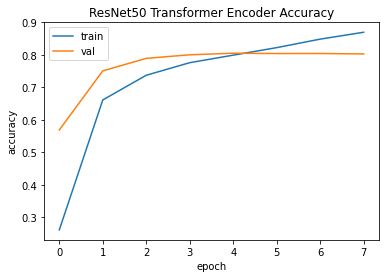

In [ ]:
plot_accuracy('ResNet50 Transformer Encoder Accuracy',history)

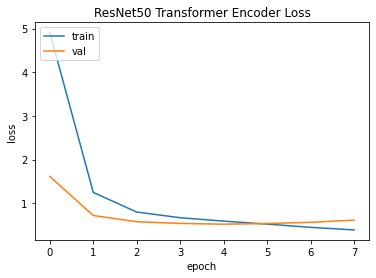

In [ ]:
plot_loss('ResNet50 Transformer Encoder Loss',history)

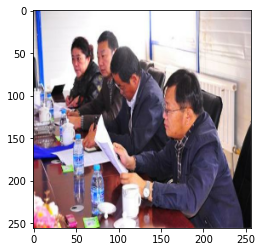

Predicted task:  workers discussing


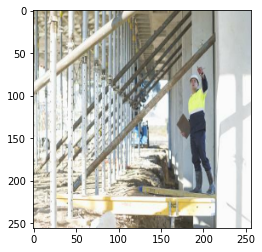

Predicted task:  workers in construction working


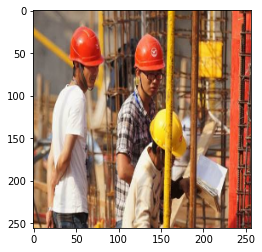

Predicted task:  workers discussing


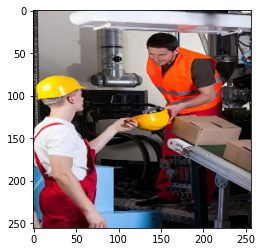

Predicted task:  worker in industry working with power tool


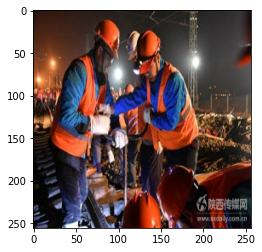

Predicted task:  workers in construction working


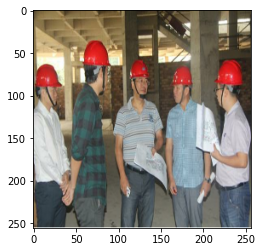

Predicted task:  workers discussing


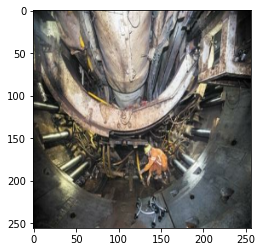

Predicted task:  workers working in a dig


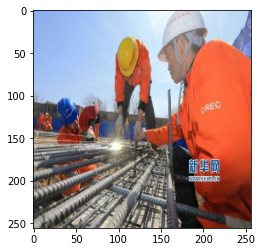

Predicted task:  workers in construction working


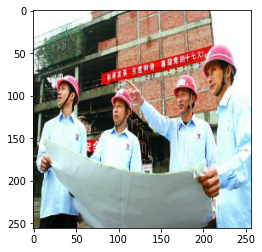

Predicted task:  workers discussing


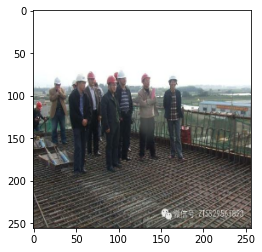

Predicted task:  workers standing


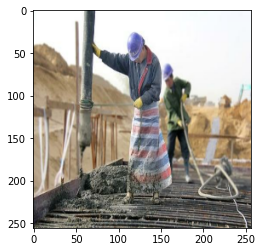

Predicted task:  workers in construction working


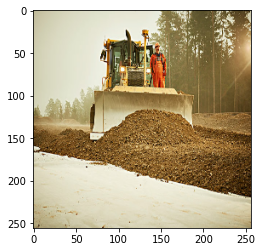

Predicted task:  worker in construction working


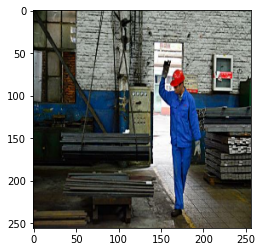

Predicted task:  worker in construction working


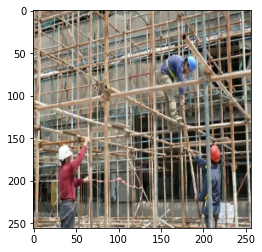

Predicted task:  workers in construction working


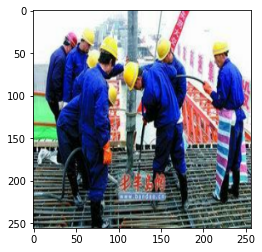

Predicted task:  workers in construction working


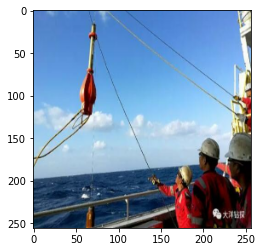

Predicted task:  workers in construction working


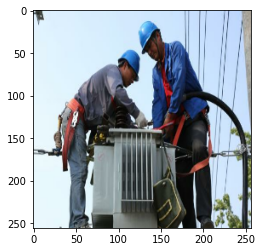

Predicted task:  workers working on electrical equipment


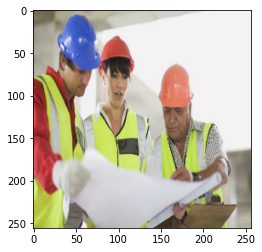

Predicted task:  workers discussing


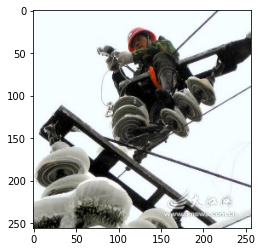

Predicted task:  worker working on electrical equipment


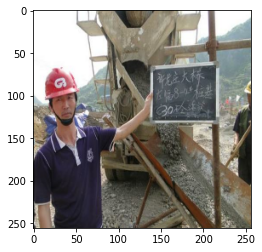

Predicted task:  workers discussing


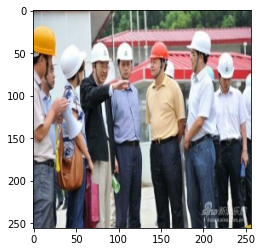

Predicted task:  workers discussing


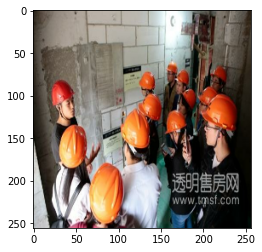

Predicted task:  workers discussing


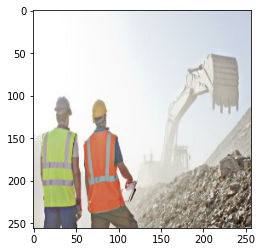

Predicted task:  workers discussing


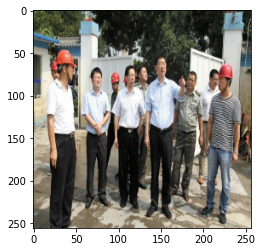

Predicted task:  workers discussing


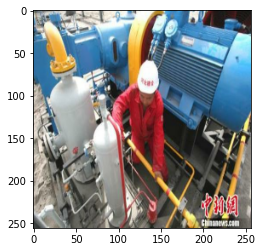

Predicted task:  workers working on electrical equipment


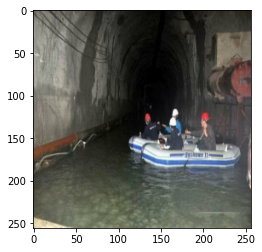

Predicted task:  workers in construction working with hand tool


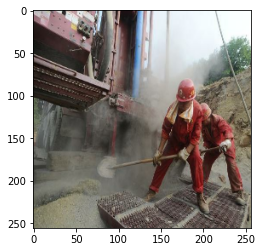

Predicted task:  workers in construction working


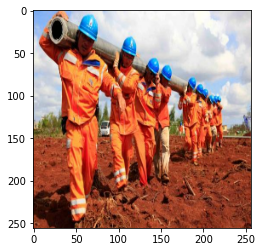

Predicted task:  workers in construction working


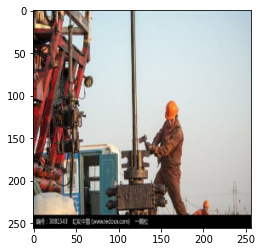

Predicted task:  worker working on electrical equipment


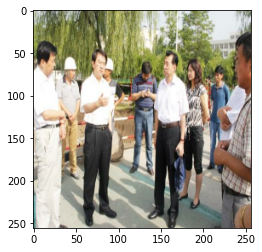

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained Inception**

In [ ]:
def pretrained_inception_v3():
    incptn = inception_v3.InceptionV3(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    incptn.trainable = False
    outputs = incptn.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(incptn.input, outputs)
    return model

In [ ]:
model = pretrained_inception_v3()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

87910968/87910968 [==============================] - 5s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 21s 300ms/step - loss: 4.7140 - acc: 0.1045 - val_loss: 1.6150 - val_acc: 0.5800
Epoch 2/15
50/50 [==============================] - 12s 245ms/step - loss: 1.3145 - acc: 0.6115 - val_loss: 0.8300 - val_acc: 0.7055
Epoch 3/15
50/50 [==============================] - 12s 246ms/step - loss: 0.9396 - acc: 0.6727 - val_loss: 0.7342 - val_acc: 0.7212
Epoch 4/15
50/50 [==============================] - 12s 247ms/step - loss: 0.8498 - acc: 0.6917 - val_loss: 0.6800 - val_acc: 0.7422
Epoch 5/15
50/50 [==============================] - 12s 247ms/step - loss: 0.7932 - acc: 0.7098 - val_loss: 0.6545 - val_acc: 0.7355
Epoch 6/15
50/50 [==============================] - 12s 246ms/step - loss: 0.7597 - acc: 0.7123 - val_loss: 0.6493 - val_acc: 0.7432
Epoch 7/15
50/50 [==============================] - 12s 246ms/step - loss: 0.7290 - acc: 0.7261 - val_loss: 0.6486 - val_acc: 0.7427
Epoch 8/15
50/50 [==============================] - 13s 249ms/step - 

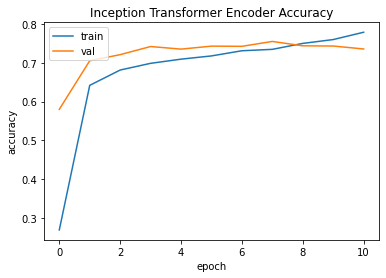

In [ ]:
plot_accuracy('Inception Transformer Encoder Accuracy',history)

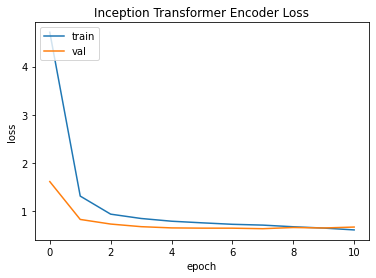

In [ ]:
plot_loss('Inception Transformer Encoder Loss',history)

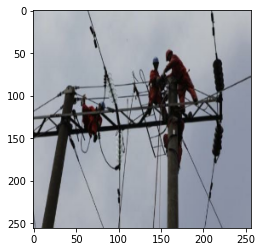

Predicted task:  workers discussing


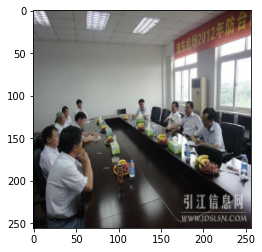

Predicted task:  workers discussing


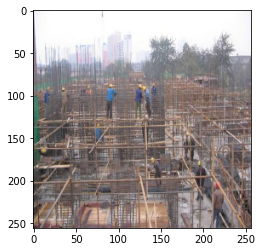

Predicted task:  workers in construction working


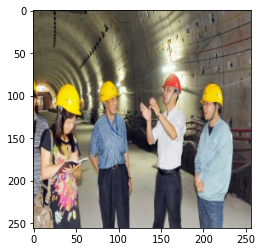

Predicted task:  workers discussing


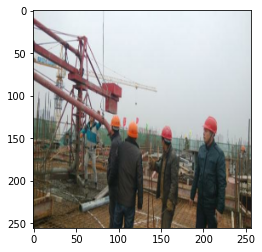

Predicted task:  workers in construction working


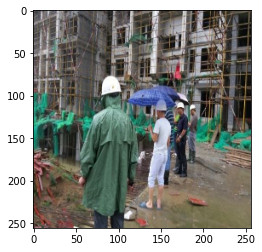

Predicted task:  workers in construction working


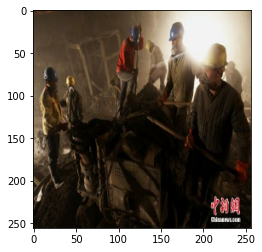

Predicted task:  workers working in a dig with hand tool


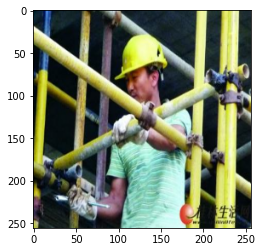

Predicted task:  workers working on electrical equipment


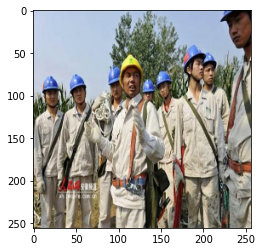

Predicted task:  workers working on electrical equipment


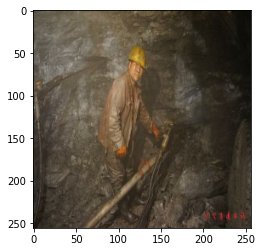

Predicted task:  workers working on electrical equipment


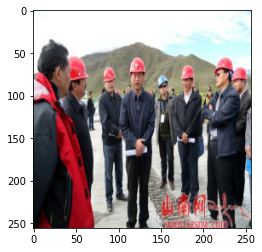

Predicted task:  workers discussing


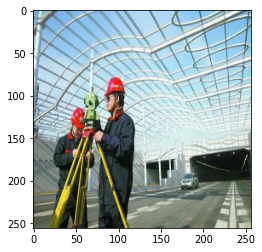

Predicted task:  workers working on electrical equipment


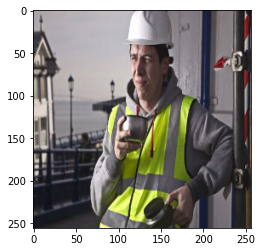

Predicted task:  workers in construction working with hand tool


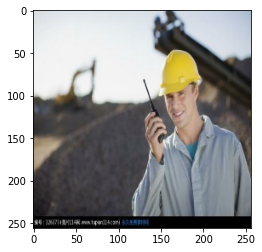

Predicted task:  workers in construction working with hand tool


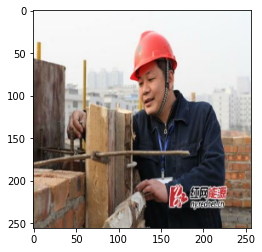

Predicted task:  workers discussing


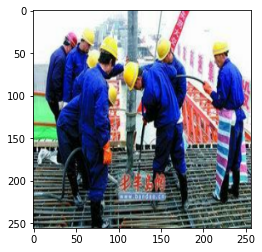

Predicted task:  workers working on electrical equipment


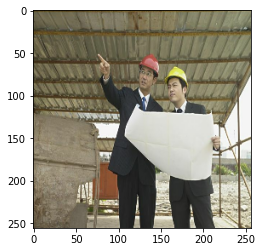

Predicted task:  workers discussing


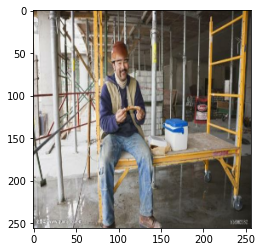

Predicted task:  workers in construction working with hand tool


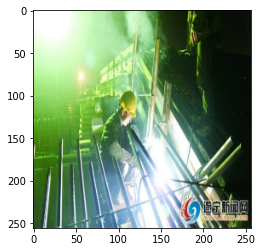

Predicted task:  workers in construction working with hand tool


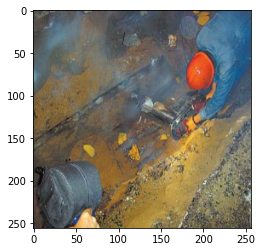

Predicted task:  workers in construction working with hand tool


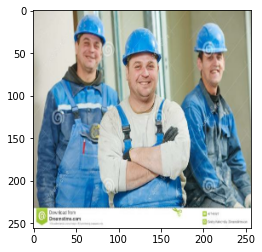

Predicted task:  workers discussing


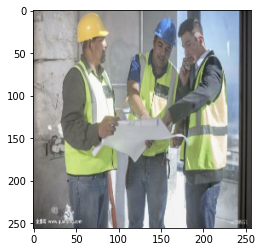

Predicted task:  workers discussing


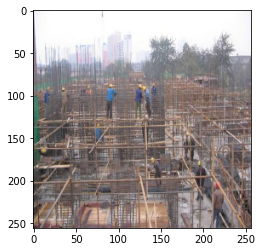

Predicted task:  workers in construction working


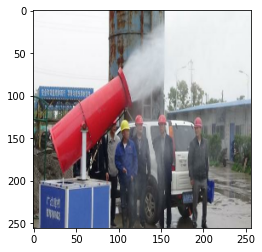

Predicted task:  workers in construction working


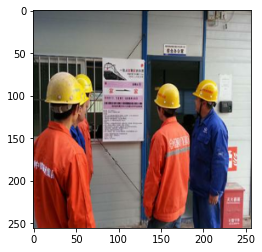

Predicted task:  workers discussing


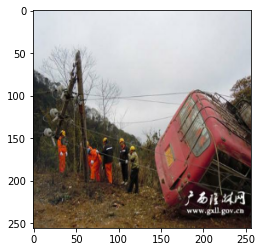

Predicted task:  workers working on electrical equipment


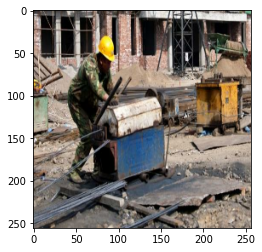

Predicted task:  workers discussing


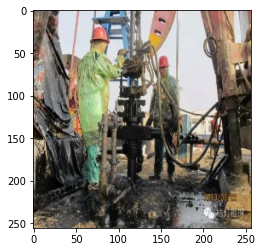

Predicted task:  workers in construction working


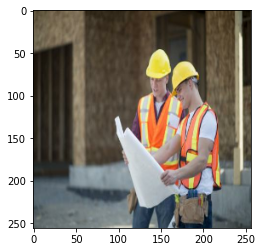

Predicted task:  workers discussing


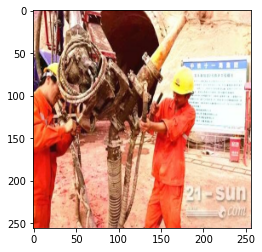

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained Xception**

In [ ]:
def pretrained_xception():
    xcept = xception.Xception(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    xcept.trainable = False
    outputs = xcept.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(xcept.input, outputs)
    return model

In [ ]:
model = pretrained_xception()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

83683744/83683744 [==============================] - 4s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 30s 499ms/step - loss: 5.0059 - acc: 0.0883 - val_loss: 1.6683 - val_acc: 0.5550
Epoch 2/15
50/50 [==============================] - 23s 459ms/step - loss: 1.3282 - acc: 0.6130 - val_loss: 0.8501 - val_acc: 0.6933
Epoch 3/15
50/50 [==============================] - 23s 454ms/step - loss: 0.9498 - acc: 0.6754 - val_loss: 0.7464 - val_acc: 0.7139
Epoch 4/15
50/50 [==============================] - 23s 451ms/step - loss: 0.8631 - acc: 0.6783 - val_loss: 0.6902 - val_acc: 0.7361
Epoch 5/15
50/50 [==============================] - 22s 445ms/step - loss: 0.7955 - acc: 0.7101 - val_loss: 0.6465 - val_acc: 0.7568
Epoch 6/15
50/50 [==============================] - 22s 447ms/step - loss: 0.7460 - acc: 0.7219 - val_loss: 0.6331 - val_acc: 0.7489
Epoch 7/15
50/50 [==============================] - 22s 440ms/step - loss: 0.7221 - acc: 0.7254 - val_loss: 0.6414 - val_acc: 0.7419
Epoch 8/15
50/50 [==============================] - 22s 444ms/step - 

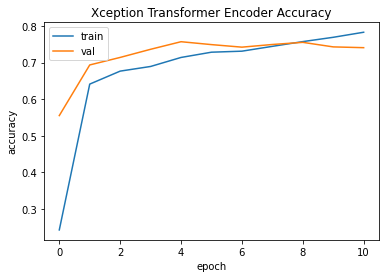

In [ ]:
plot_accuracy('Xception Transformer Encoder Accuracy',history)

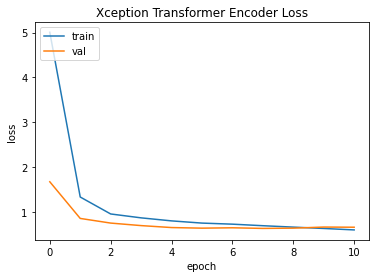

In [ ]:
plot_loss('Xception Transformer Encoder Loss',history)

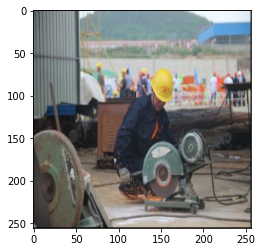

Predicted task:  workers in construction working


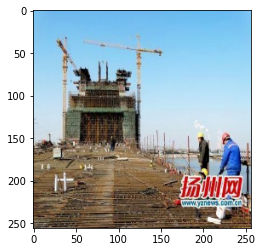

Predicted task:  workers in construction working with hand tool


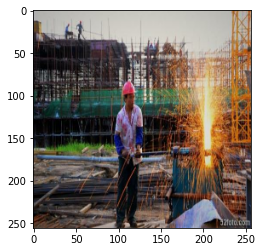

Predicted task:  workers in construction working


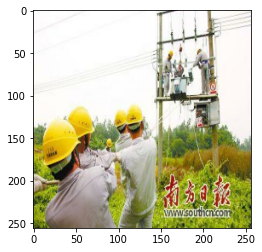

Predicted task:  workers working on electrical equipment


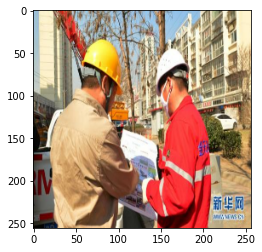

Predicted task:  workers working on electrical equipment


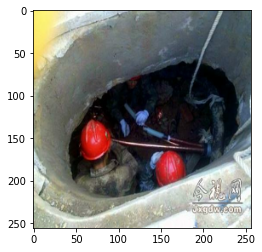

Predicted task:  workers in construction working


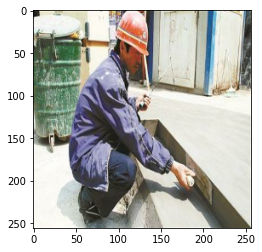

Predicted task:  workers working on electrical equipment


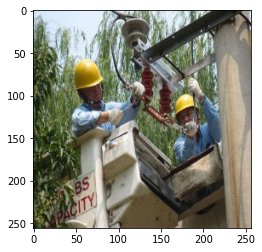

Predicted task:  workers working on electrical equipment


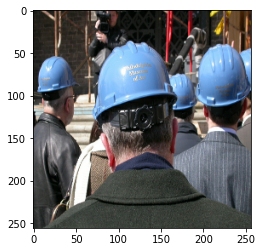

Predicted task:  workers working on electrical equipment


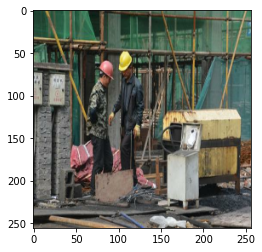

Predicted task:  workers in construction working


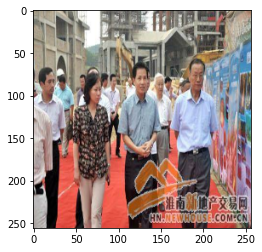

Predicted task:  workers working on electrical equipment


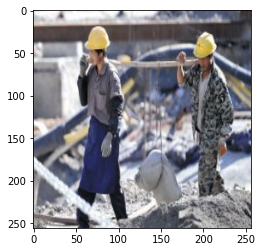

Predicted task:  workers discussing


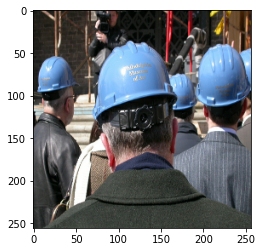

Predicted task:  workers working on electrical equipment


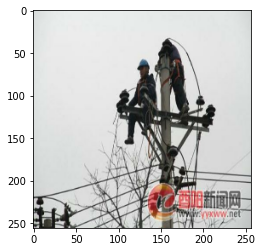

Predicted task:  workers working on electrical equipment


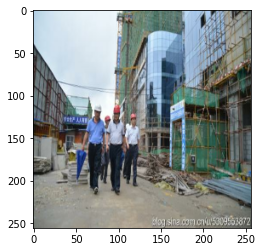

Predicted task:  workers working on electrical equipment


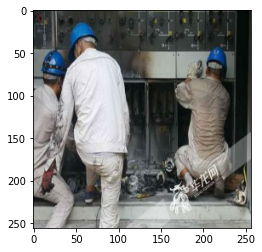

Predicted task:  workers working on electrical equipment


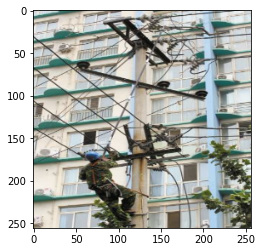

Predicted task:  workers working on electrical equipment


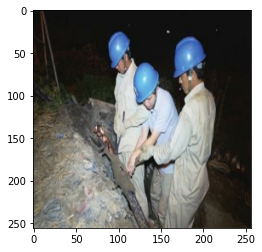

Predicted task:  workers discussing


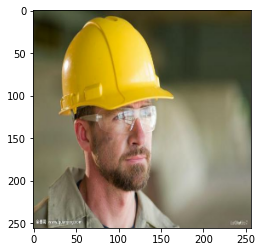

Predicted task:  worker working on electrical equipment


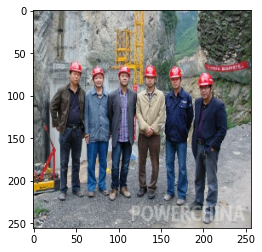

Predicted task:  workers in construction working


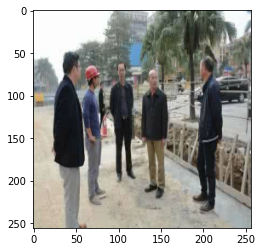

Predicted task:  workers discussing


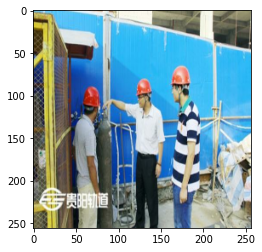

Predicted task:  workers working on electrical equipment


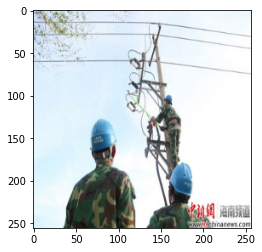

Predicted task:  workers working on electrical equipment


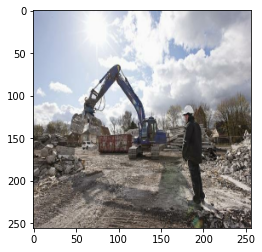

Predicted task:  workers in construction working with hand tool


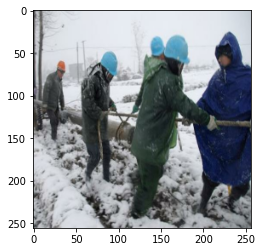

Predicted task:  workers discussing


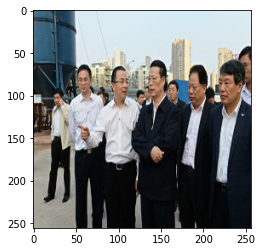

Predicted task:  workers discussing


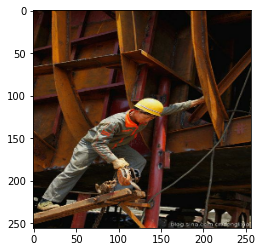

Predicted task:  workers working on industrial equipment


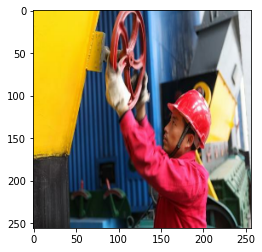

Predicted task:  workers in construction working with hand tool


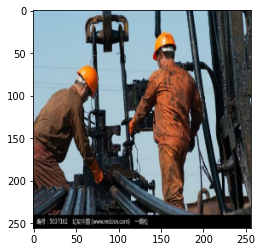

Predicted task:  workers working on electrical equipment


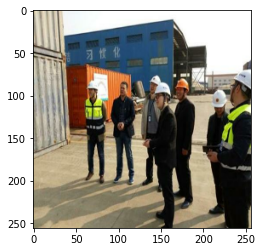

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained EfficientNet**

In [ ]:
def pretrained_efficientnet():
    effnet = efficientnet.EfficientNetB0(
        input_shape=(*IMG_SIZE, 3), include_top=False, weights="imagenet",
    )
    # We freeze our feature extractor
    effnet.trainable = False
    outputs = effnet.output
    outputs = layers.Reshape((-1, outputs.shape[-1]))(outputs)
    model = keras.models.Model(effnet.input, outputs)
    return model

In [ ]:
model = pretrained_efficientnet()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=1)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=2)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

16705208/16705208 [==============================] - 2s 0us/step


In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 19s 285ms/step - loss: 5.1140 - acc: 0.0914 - val_loss: 1.7571 - val_acc: 0.5814
Epoch 2/15
50/50 [==============================] - 12s 238ms/step - loss: 1.2878 - acc: 0.6180 - val_loss: 0.7259 - val_acc: 0.7538
Epoch 3/15
50/50 [==============================] - 12s 240ms/step - loss: 0.7941 - acc: 0.7364 - val_loss: 0.5675 - val_acc: 0.7969
Epoch 4/15
50/50 [==============================] - 12s 242ms/step - loss: 0.6607 - acc: 0.7748 - val_loss: 0.5191 - val_acc: 0.8078
Epoch 5/15
50/50 [==============================] - 12s 240ms/step - loss: 0.5833 - acc: 0.8005 - val_loss: 0.5254 - val_acc: 0.8173
Epoch 6/15
50/50 [==============================] - 12s 241ms/step - loss: 0.5235 - acc: 0.8183 - val_loss: 0.5115 - val_acc: 0.8162
Epoch 7/15
50/50 [==============================] - 12s 238ms/step - loss: 0.4651 - acc: 0.8458 - val_loss: 0.5232 - val_acc: 0.8148
Epoch 8/15
50/50 [==============================] - 12s 236ms/step - 

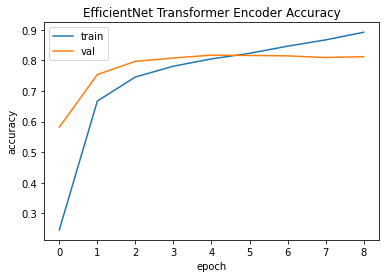

In [ ]:
plot_accuracy('EfficientNet Transformer Encoder Accuracy',history)

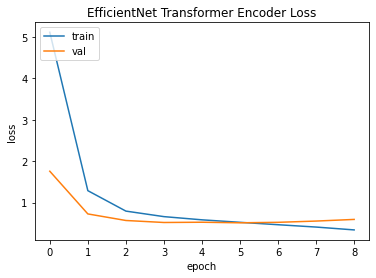

In [ ]:
plot_loss('EfficientNet Transformer Encoder Loss',history)

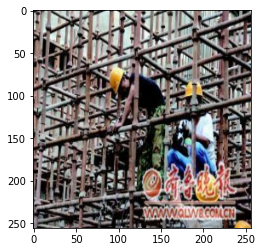

Predicted task:  workers working on industrial equipment


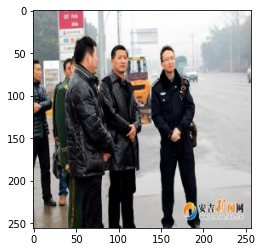

Predicted task:  workers discussing


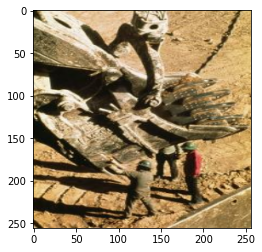

Predicted task:  workers in construction working with hand tool


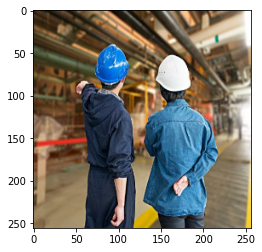

Predicted task:  workers discussing


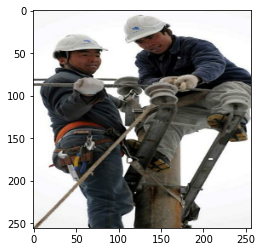

Predicted task:  workers working on industrial equipment


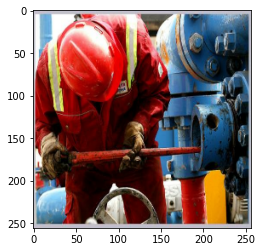

Predicted task:  worker working on industrial equipment


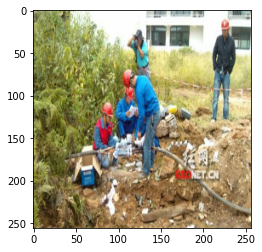

Predicted task:  workers in construction working with hand tool


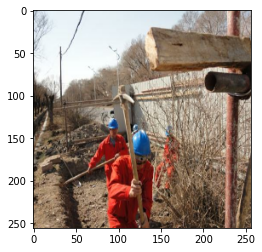

Predicted task:  workers working on electrical equipment


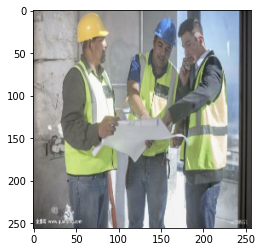

Predicted task:  workers discussing


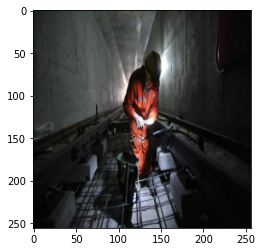

Predicted task:  worker in construction working with hand tool


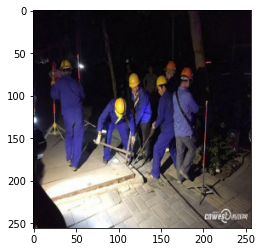

Predicted task:  workers in construction working with hand tool


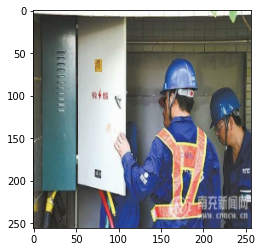

Predicted task:  workers discussing


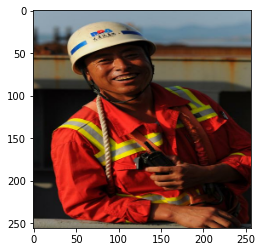

Predicted task:  workers in construction working


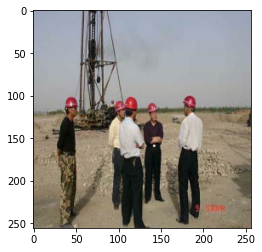

Predicted task:  workers discussing


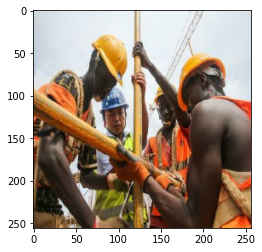

Predicted task:  workers in construction working


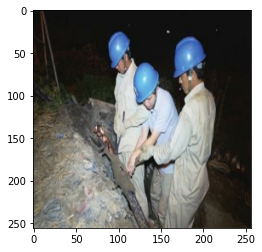

Predicted task:  workers in construction working with hand tool


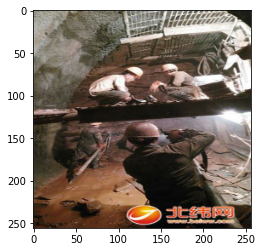

Predicted task:  workers in construction working with hand tool


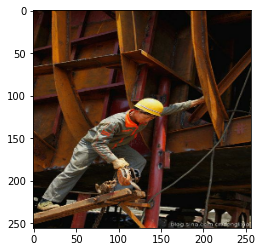

Predicted task:  workers in construction working


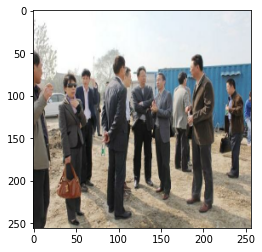

Predicted task:  workers discussing


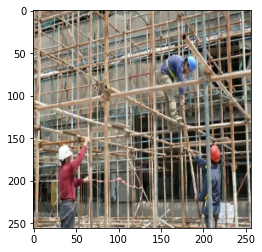

Predicted task:  workers in construction working


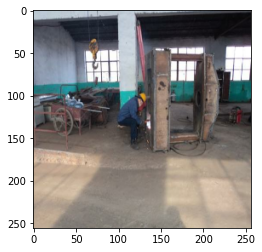

Predicted task:  workers in construction working


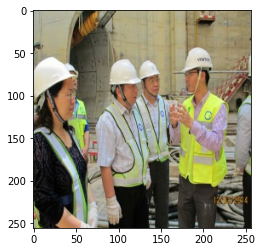

Predicted task:  workers discussing


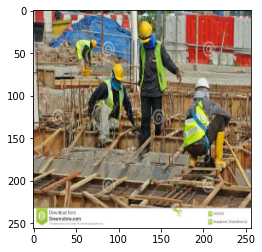

Predicted task:  workers in construction working with hand tool


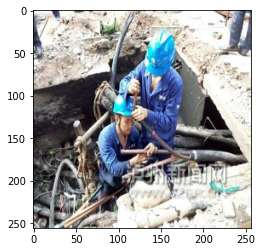

Predicted task:  workers in construction working with hand tool


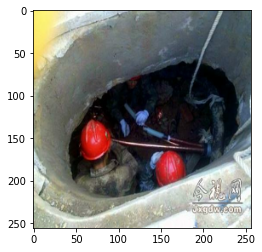

Predicted task:  workers in construction working with hand tool


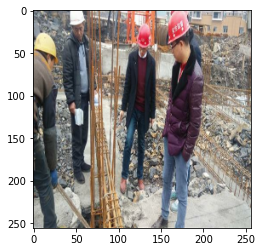

Predicted task:  workers discussing


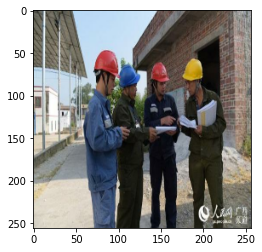

Predicted task:  workers discussing


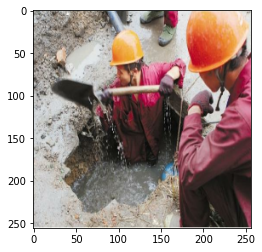

Predicted task:  workers in construction working with hand tool


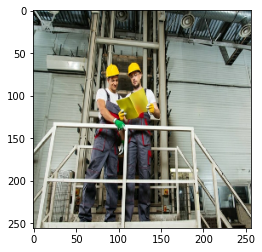

Predicted task:  workers discussing


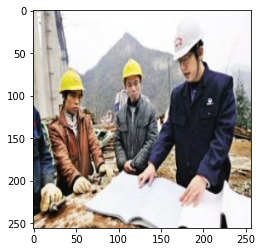

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

**Attention Hyperparameters**

There are three hyperparameters that determine the data dimensions:

    1. Embedding Size — width of the embedding vector . This dimension is carried forward throughout the Transformer model and hence is sometimes referred to by other names like ‘model size’ etc.
    2. Query Size (equal to Key and Value size)— the size of the weights used by three Linear layers to produce the Query, Key, and Value matrices respectively (we use a Query size of 3 in our example)
    3. Number of Attention heads (we use 2 heads in our example)

In addition, we also have the Batch size, giving us one dimension for the number of samples.

### **Implementing Transformer model with pretrained EfficientNet**
With double Embedding Size and Feed forward Network Neurons

In [ ]:
# Set dimension for the image embeddings and token embeddings
EMBED_DIM = 1024

# Set per-layer units in the feed-forward network
FF_DIM = 1024


In [ ]:
model = pretrained_efficientnet()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=2)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=4)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 26s 430ms/step - loss: 3.4647 - acc: 0.1960 - val_loss: 0.7591 - val_acc: 0.7557
Epoch 2/15
50/50 [==============================] - 19s 387ms/step - loss: 0.7821 - acc: 0.7216 - val_loss: 0.5323 - val_acc: 0.8043
Epoch 3/15
50/50 [==============================] - 19s 388ms/step - loss: 0.6100 - acc: 0.7838 - val_loss: 0.5463 - val_acc: 0.8125
Epoch 4/15
50/50 [==============================] - 20s 394ms/step - loss: 0.5311 - acc: 0.8121 - val_loss: 0.5241 - val_acc: 0.8110
Epoch 5/15
50/50 [==============================] - 20s 392ms/step - loss: 0.4322 - acc: 0.8438 - val_loss: 0.5654 - val_acc: 0.8131
Epoch 6/15
50/50 [==============================] - 20s 394ms/step - loss: 0.3449 - acc: 0.8751 - val_loss: 0.5876 - val_acc: 0.8159
Epoch 7/15
50/50 [==============================] - 20s 400ms/step - loss: 0.2484 - acc: 0.9083 - val_loss: 0.6979 - val_acc: 0.8050


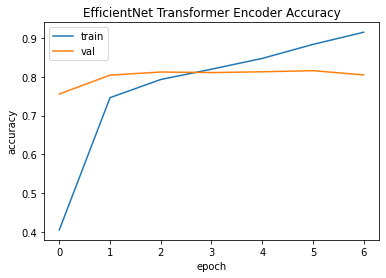

In [ ]:
plot_accuracy('EfficientNet Transformer Encoder Accuracy',history)

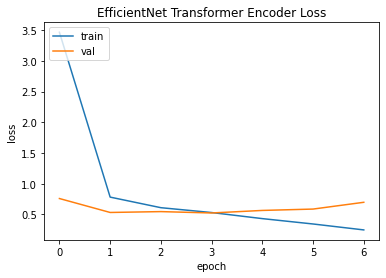

In [ ]:
plot_loss('EfficientNet Transformer Encoder Loss',history)

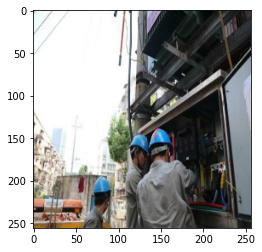

Predicted task:  workers working on electrical equipment


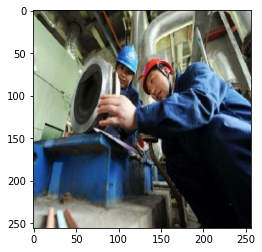

Predicted task:  worker working on industrial equipment


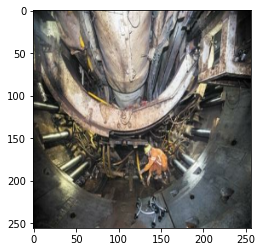

Predicted task:  worker working on industrial equipment


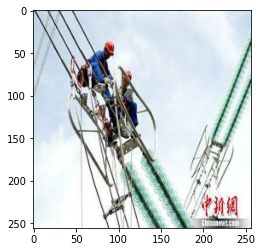

Predicted task:  workers working on electrical equipment


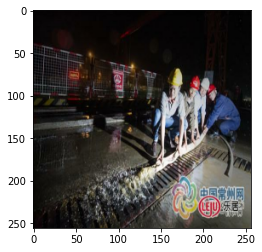

Predicted task:  workers discussing


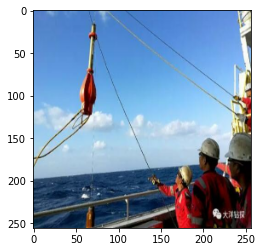

Predicted task:  workers working on electrical equipment


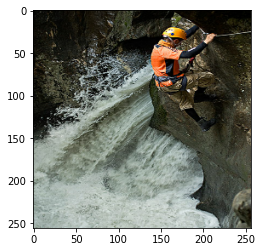

Predicted task:  worker in construction working with hand tool


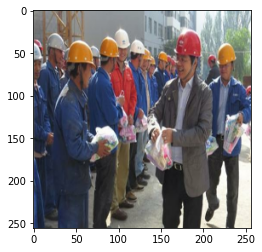

Predicted task:  workers discussing


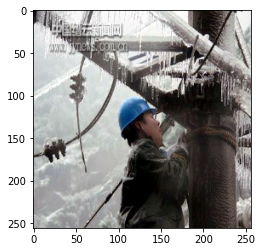

Predicted task:  workers working on electrical equipment


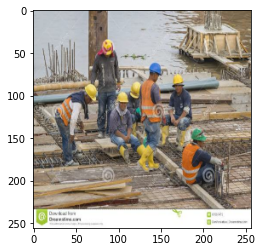

Predicted task:  workers in construction working


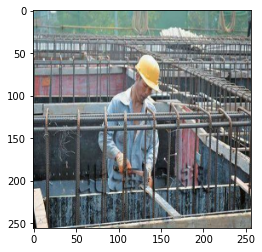

Predicted task:  workers in construction working


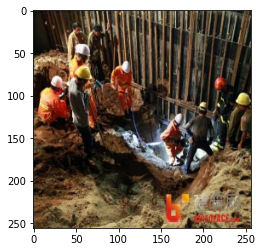

Predicted task:  workers in construction working


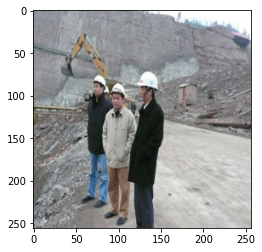

Predicted task:  workers discussing


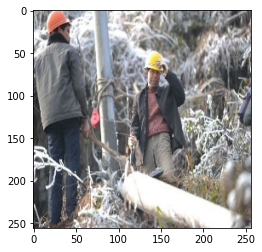

Predicted task:  workers working on electrical equipment


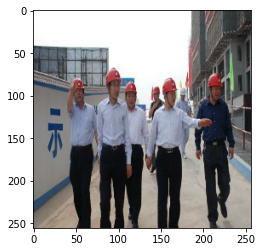

Predicted task:  workers discussing


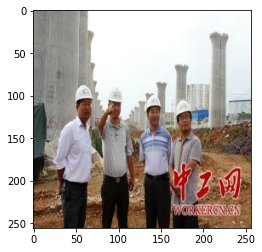

Predicted task:  workers discussing


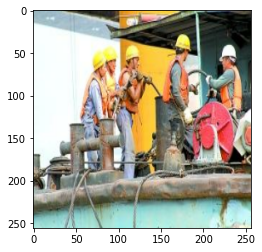

Predicted task:  workers discussing


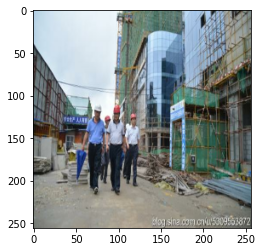

Predicted task:  workers discussing


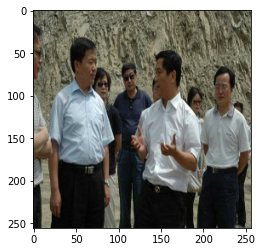

Predicted task:  workers discussing


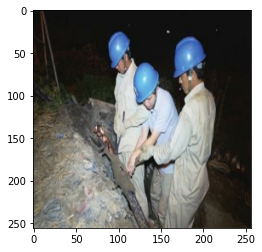

Predicted task:  workers in construction working


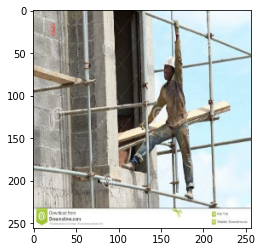

Predicted task:  workers working on electrical equipment


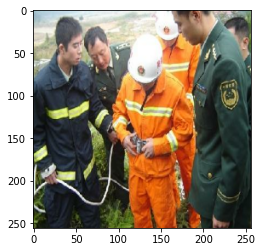

Predicted task:  workers discussing


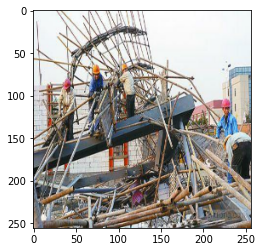

Predicted task:  workers in construction working


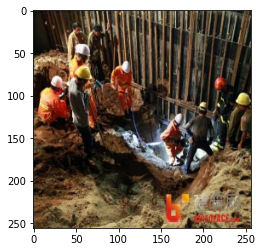

Predicted task:  workers in construction working


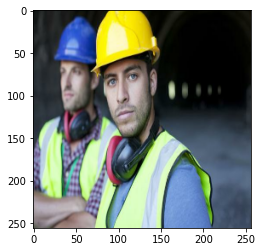

Predicted task:  worker standing


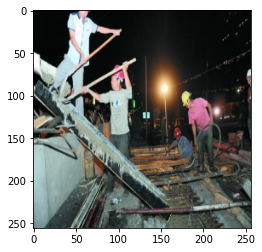

Predicted task:  workers in construction working


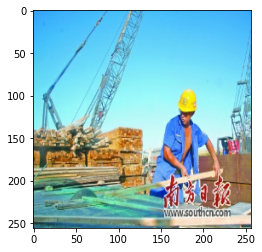

Predicted task:  workers discussing


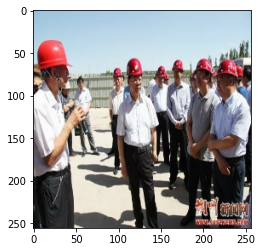

Predicted task:  workers discussing


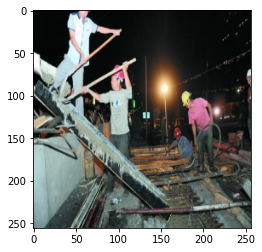

Predicted task:  workers in construction working


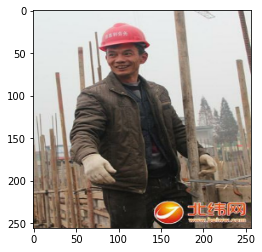

Predicted task:  workers discussing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained EfficientNet**
With double Batch size

In [ ]:
BATCH_SIZE = 128

# Set dimension for the image embeddings and token embeddings
EMBED_DIM = 512

# Set per-layer units in the feed-forward network
FF_DIM = 512


In [ ]:
# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()))

valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()))

In [ ]:
model = pretrained_efficientnet()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=2)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=4)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
25/25 [==============================] - 20s 577ms/step - loss: 6.4029 - acc: 0.0226 - val_loss: 3.7265 - val_acc: 0.3533
Epoch 2/15
25/25 [==============================] - 13s 500ms/step - loss: 2.7084 - acc: 0.4141 - val_loss: 1.4223 - val_acc: 0.6464
Epoch 3/15
25/25 [==============================] - 13s 497ms/step - loss: 1.2880 - acc: 0.6327 - val_loss: 0.8097 - val_acc: 0.7430
Epoch 4/15
25/25 [==============================] - 13s 500ms/step - loss: 0.8753 - acc: 0.7244 - val_loss: 0.6304 - val_acc: 0.7716
Epoch 5/15
25/25 [==============================] - 13s 500ms/step - loss: 0.7186 - acc: 0.7594 - val_loss: 0.5371 - val_acc: 0.8081
Epoch 6/15
25/25 [==============================] - 13s 498ms/step - loss: 0.6242 - acc: 0.7853 - val_loss: 0.5346 - val_acc: 0.7941
Epoch 7/15
25/25 [==============================] - 13s 499ms/step - loss: 0.5737 - acc: 0.7999 - val_loss: 0.5235 - val_acc: 0.8134
Epoch 8/15
25/25 [==============================] - 13s 497ms/step - 

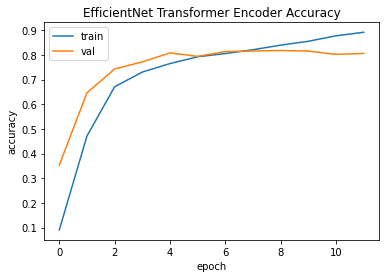

In [ ]:
plot_accuracy('EfficientNet Transformer Encoder Accuracy',history)

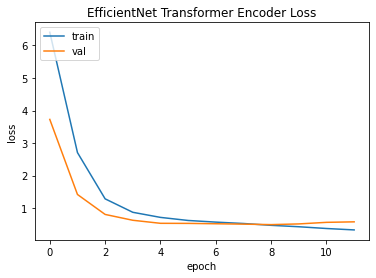

In [ ]:
plot_loss('EfficientNet Transformer Encoder Loss',history)

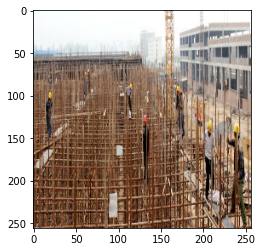

Predicted task:  workers in construction working


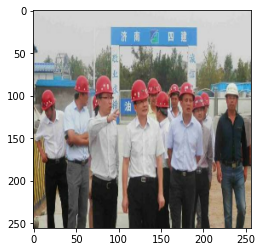

Predicted task:  workers discussing


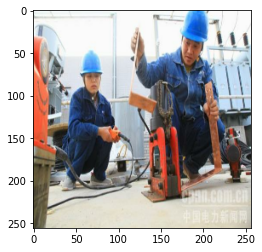

Predicted task:  workers in construction working with hand tool


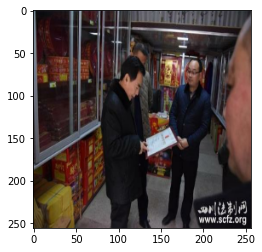

Predicted task:  workers discussing


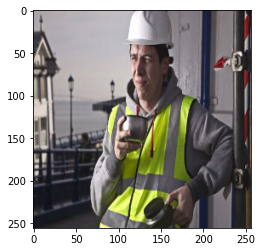

Predicted task:  worker in construction working


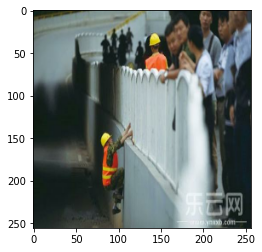

Predicted task:  workers discussing


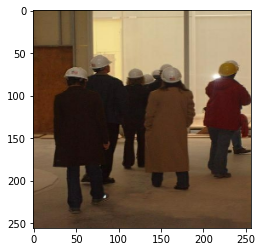

Predicted task:  workers discussing


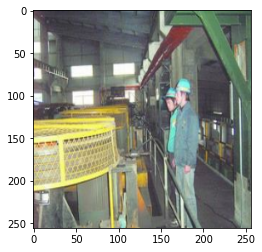

Predicted task:  worker standing


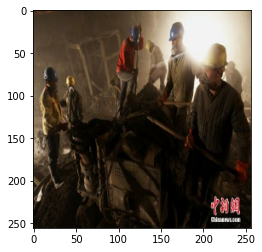

Predicted task:  workers in construction working with hand tool


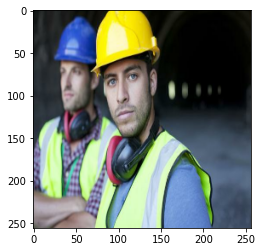

Predicted task:  worker standing


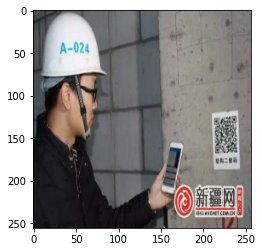

Predicted task:  workers discussing


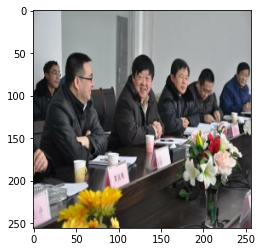

Predicted task:  workers discussing


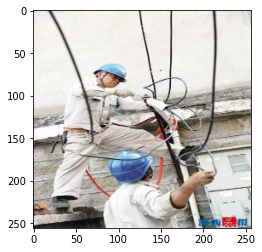

Predicted task:  worker working on electrical equipment


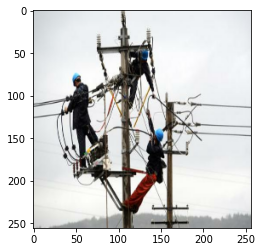

Predicted task:  workers working on electrical equipment


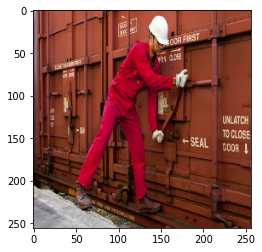

Predicted task:  worker in construction working


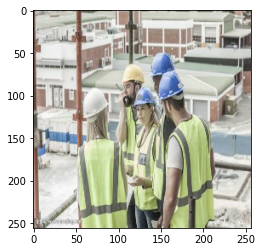

Predicted task:  workers discussing


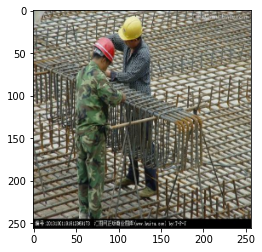

Predicted task:  workers in construction working


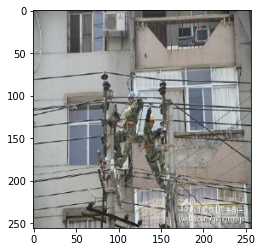

Predicted task:  workers working on electrical equipment


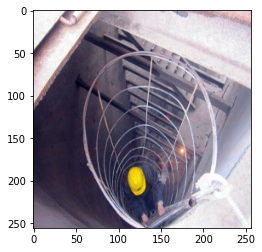

Predicted task:  worker in construction working with hand tool


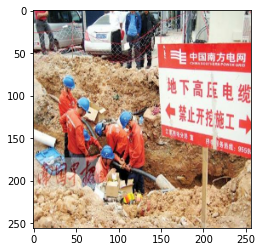

Predicted task:  workers in construction working with hand tool


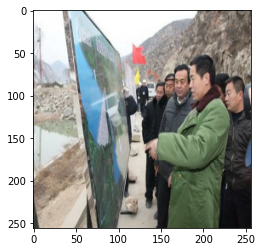

Predicted task:  workers in construction working


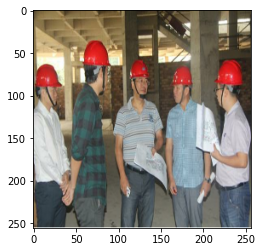

Predicted task:  workers discussing


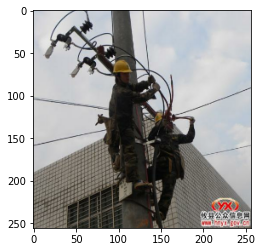

Predicted task:  workers working on electrical equipment


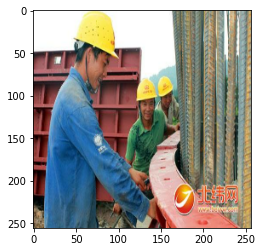

Predicted task:  workers discussing


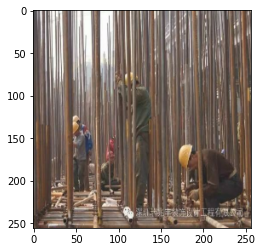

Predicted task:  workers in construction working


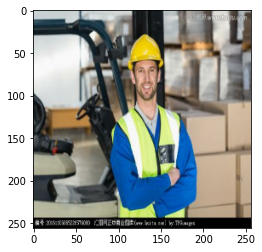

Predicted task:  worker standing


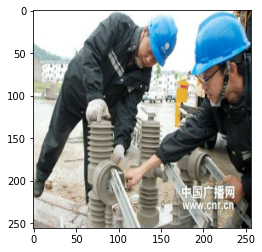

Predicted task:  workers working on electrical equipment


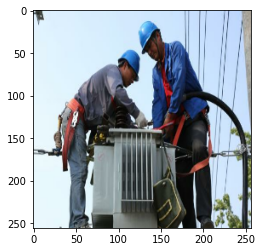

Predicted task:  workers working on electrical equipment


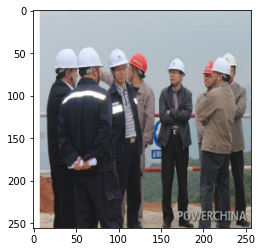

Predicted task:  workers discussing


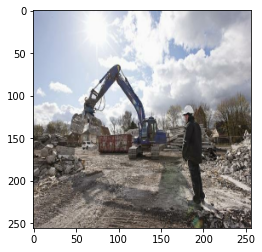

Predicted task:  workers in construction working


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()

### **Implementing Transformer model with pretrained EfficientNet**
With double Image size

In [ ]:
IMG_SIZE = (512, 512)

BATCH_SIZE = 64

# Set dimension for the image embeddings and token embeddings
EMBED_DIM = 512

# Set per-layer units in the feed-forward network
FF_DIM = 512

In [ ]:
#Prepare training and validation data
def process_input(img_path, captions):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img,IMG_SIZE)
    img = tf.image.convert_image_dtype(img, tf.float32)
    cap=vectorize(captions)
    return img,cap 


def make_dataset(images, captions):
    dataset = tf.data.Dataset.from_tensor_slices((images, captions))
    dataset = dataset.shuffle(BATCH_SIZE * 8)
    dataset = dataset.map(process_input, num_parallel_calls=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE).prefetch(AUTOTUNE)
    return dataset


# Pass the list of images and the list of corresponding captions
train_dataset = make_dataset(list(train_data.keys()), list(train_data.values()))

valid_dataset = make_dataset(list(valid_data.keys()), list(valid_data.values()))

In [ ]:
vocab = vectorize.get_vocabulary()
index_lookup = dict(zip(range(len(vocab)), vocab))
max_decoded_sentence_length = SEQ_LENGTH - 1
valid_images = list(valid_data.keys())

def generate_caption():
    # Select a random image from the validation dataset
    sample_img = np.random.choice(valid_images)

    # Read the image from the disk
    read_img = tf.io.read_file(sample_img)
    dec_img = tf.image.decode_jpeg(read_img, channels=3)
    res_img = tf.image.resize(dec_img,IMG_SIZE)
    sample_img = tf.image.convert_image_dtype(res_img, tf.float32)
    img = sample_img.numpy().clip(0, 255).astype(np.uint8)
    plt.imshow(img)
    plt.show()

    # Pass the image to the CNN
    img = tf.expand_dims(sample_img, 0)
    img = caption_model.cnn_model(img)

    # Pass the image features to the Transformer encoder
    encoded_img = caption_model.encoder(img, training=False)

    # Generate the caption using the Transformer decoder
    decoded_caption = "<start> "
    for i in range(max_decoded_sentence_length):
        tokenized_caption = vectorize([decoded_caption])[:, :-1]
        mask = tf.math.not_equal(tokenized_caption, 0)
        predictions = caption_model.decoder(
            tokenized_caption, encoded_img, training=False, mask=mask
        )
        sampled_token_index = np.argmax(predictions[0, i, :])
        sampled_token = index_lookup[sampled_token_index]
        if sampled_token == "end":
            break
        decoded_caption += " " + sampled_token

    decoded_caption = decoded_caption.replace("<start> ", "")
    decoded_caption = decoded_caption.replace(" <end>", "").strip()
    print("Predicted task: ", decoded_caption)

In [ ]:
model = pretrained_efficientnet()
encoder = TransformerEncoder(embed_dim=EMBED_DIM, dense_dim=FF_DIM, num_heads=2)
decoder = TransformerDecoder(embed_dim=EMBED_DIM, ff_dim=FF_DIM, num_heads=4)
caption_model = TaskIdentification(
    cnn_model=model, encoder=encoder, decoder=decoder, image_aug=image_augmentation,
)

In [ ]:
# Compile the model
caption_model.compile(optimizer=keras.optimizers.Adam(lr_schedule), loss=cross_entropy)

# Fit the model
history =caption_model.fit(
    train_dataset,
    epochs=EPOCHS,
    validation_data=valid_dataset,
    callbacks=[early_stopping],
)

Epoch 1/15
50/50 [==============================] - 53s 938ms/step - loss: 4.7012 - acc: 0.1100 - val_loss: 1.5411 - val_acc: 0.6196
Epoch 2/15
50/50 [==============================] - 44s 882ms/step - loss: 1.1619 - acc: 0.6560 - val_loss: 0.6757 - val_acc: 0.7608
Epoch 3/15
50/50 [==============================] - 44s 873ms/step - loss: 0.7478 - acc: 0.7413 - val_loss: 0.5519 - val_acc: 0.8020
Epoch 4/15
50/50 [==============================] - 44s 869ms/step - loss: 0.6242 - acc: 0.7843 - val_loss: 0.5176 - val_acc: 0.8065
Epoch 5/15
50/50 [==============================] - 44s 879ms/step - loss: 0.5577 - acc: 0.8047 - val_loss: 0.4800 - val_acc: 0.8249
Epoch 6/15
50/50 [==============================] - 44s 868ms/step - loss: 0.4948 - acc: 0.8273 - val_loss: 0.4878 - val_acc: 0.8229
Epoch 7/15
50/50 [==============================] - 43s 867ms/step - loss: 0.4484 - acc: 0.8455 - val_loss: 0.4934 - val_acc: 0.8228
Epoch 8/15
50/50 [==============================] - 43s 867ms/step - 

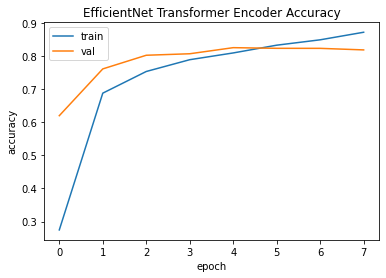

In [ ]:
plot_accuracy('EfficientNet Transformer Encoder Accuracy',history)

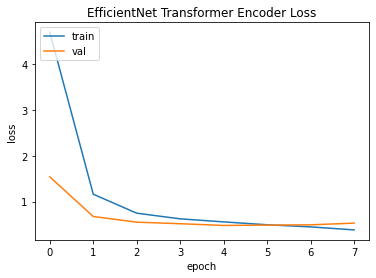

In [ ]:
plot_loss('EfficientNet Transformer Encoder Loss',history)

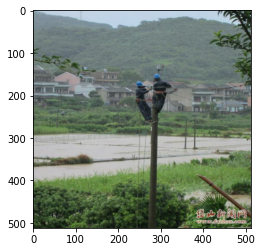

Predicted task:  workers working on electrical equipment


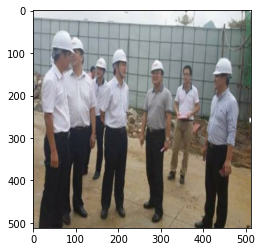

Predicted task:  workers discussing


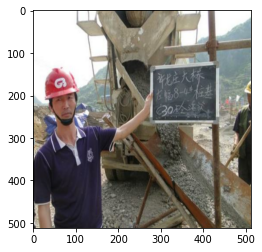

Predicted task:  worker standing


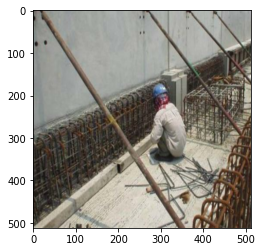

Predicted task:  worker in construction working


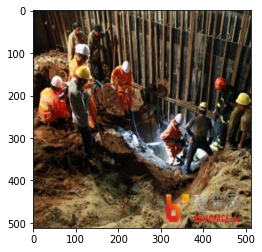

Predicted task:  workers in construction working


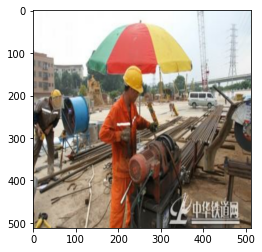

Predicted task:  workers in construction working


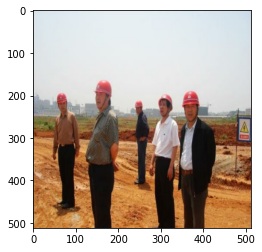

Predicted task:  workers discussing


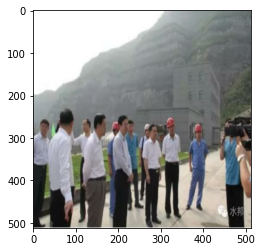

Predicted task:  workers discussing


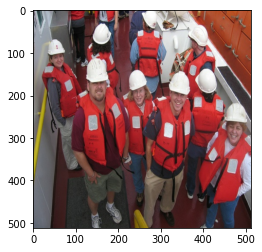

Predicted task:  workers discussing


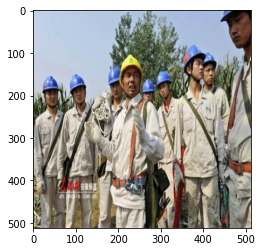

Predicted task:  workers discussing


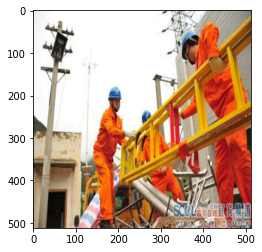

Predicted task:  workers working on electrical equipment


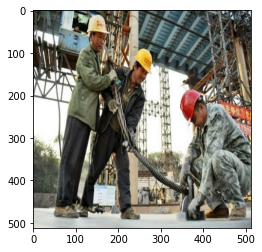

Predicted task:  workers working on electrical equipment


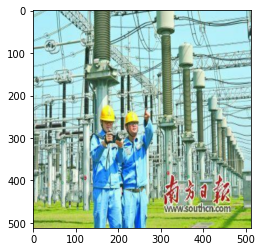

Predicted task:  workers working on electrical equipment


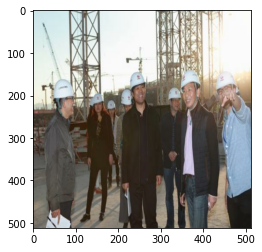

Predicted task:  workers discussing


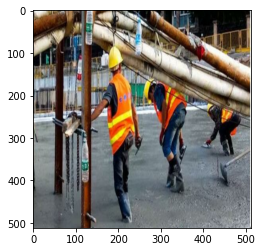

Predicted task:  workers in construction working with hand tool


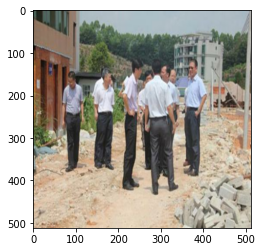

Predicted task:  workers discussing


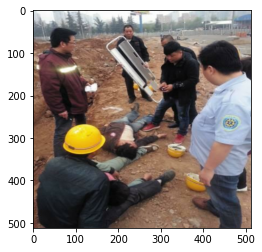

Predicted task:  workers discussing


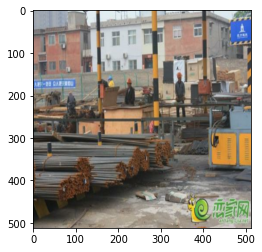

Predicted task:  workers in construction working


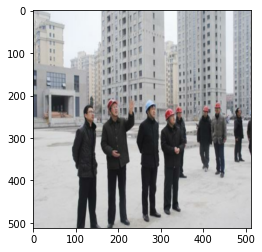

Predicted task:  workers discussing


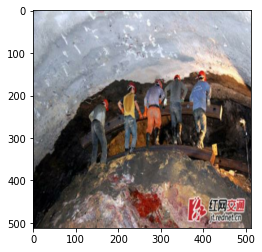

Predicted task:  workers in construction working with hand tool


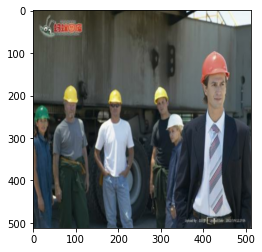

Predicted task:  workers discussing


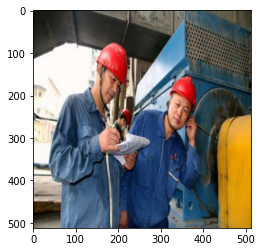

Predicted task:  workers working on electrical equipment


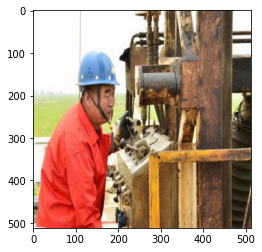

Predicted task:  worker in construction working with power tool


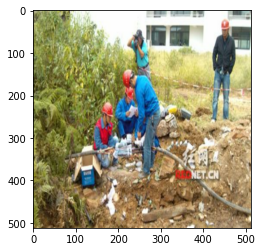

Predicted task:  workers in construction working with hand tool


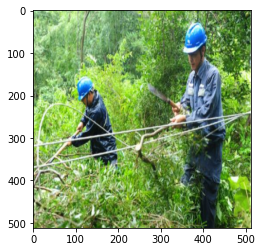

Predicted task:  workers working on electrical equipment


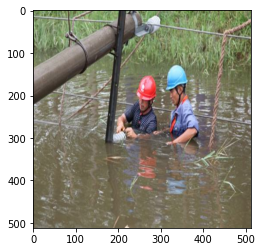

Predicted task:  workers in construction working with hand tool


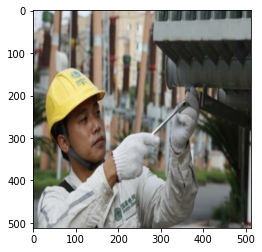

Predicted task:  worker in construction working with hand tool


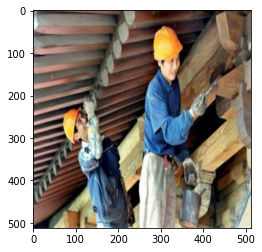

Predicted task:  worker in construction working with hand tool


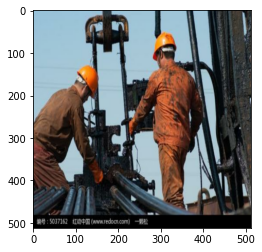

Predicted task:  workers working on electrical equipment


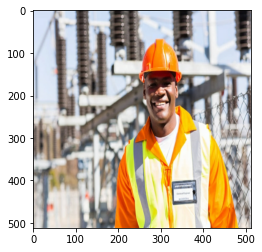

Predicted task:  worker standing


In [ ]:
# Check predictions for a few samples
for i in range(0,30):
  generate_caption()